# 人脸生成（Face Generation）
在该项目中，你将使用生成式对抗网络（Generative Adversarial Nets）来生成新的人脸图像。
### 获取数据
该项目将使用以下数据集：
- MNIST
- CelebA

由于 CelebA 数据集比较复杂，而且这是你第一次使用 GANs。我们想让你先在 MNIST 数据集上测试你的 GANs 模型，以让你更快的评估所建立模型的性能。

如果你在使用 [FloydHub](https://www.floydhub.com/), 请将 `data_dir` 设置为 "/input" 并使用 [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data/'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## 探索数据（Explore the Data）
### MNIST
[MNIST](http://yann.lecun.com/exdb/mnist/) 是一个手写数字的图像数据集。你可以更改 `show_n_images` 探索此数据集。

(5, 5, 28, 28, 1)
(5, 5, 28, 28)
(25, 28, 28, 1)


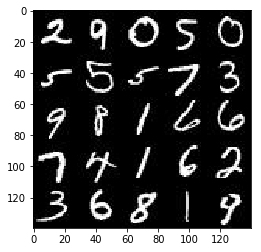

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot
import numpy as np

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')
print(mnist_images.shape)

### CelebA
[CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) 是一个包含 20 多万张名人图片及相关图片说明的数据集。你将用此数据集生成人脸，不会用不到相关说明。你可以更改 `show_n_images` 探索此数据集。

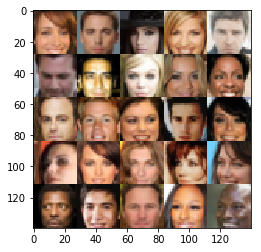

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## 预处理数据（Preprocess the Data）
由于该项目的重点是建立 GANs 模型，我们将为你预处理数据。

经过数据预处理，MNIST 和 CelebA 数据集的值在 28×28 维度图像的 [-0.5, 0.5] 范围内。CelebA 数据集中的图像裁剪了非脸部的图像部分，然后调整到 28x28 维度。

MNIST 数据集中的图像是单[通道](https://en.wikipedia.org/wiki/Channel_(digital_image%29)的黑白图像，CelebA 数据集中的图像是 [三通道的 RGB 彩色图像](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images)。

## 建立神经网络（Build the Neural Network）
你将通过部署以下函数来建立 GANs 的主要组成部分:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### 检查 TensorFlow 版本并获取 GPU 型号
检查你是否使用正确的 TensorFlow 版本，并获取 GPU 型号

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.2.0-rc1
Default GPU Device: /gpu:0


### 输入（Input）
部署 `model_inputs` 函数以创建用于神经网络的 [占位符 (TF Placeholders)](https://www.tensorflow.org/versions/r0.11/api_docs/python/io_ops/placeholders)。请创建以下占位符：
- 输入图像占位符: 使用 `image_width`，`image_height` 和 `image_channels` 设置为 rank 4。
- 输入 Z 占位符: 设置为 rank 2，并命名为 `z_dim`。
- 学习速率占位符: 设置为 rank 0。

返回占位符元组的形状为 (tensor of real input images, tensor of z data, learning rate)。


In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    inputs_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='inputs_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    learning_rate = tf.placeholder(tf.float32, (None))
    
    return inputs_real, inputs_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

ERROR:tensorflow:==================================
Object was never used (type <class 'tensorflow.python.framework.ops.Operation'>):
name: "assert_rank_2/Assert/Assert"
op: "Assert"
input: "assert_rank_2/Equal"
input: "assert_rank_2/Assert/Assert/data_0"
input: "assert_rank_2/Assert/Assert/data_1"
input: "assert_rank_2/rank"
input: "assert_rank_2/Assert/Assert/data_3"
input: "assert_rank_2/Shape"
attr {
  key: "T"
  value {
    list {
      type: DT_STRING
      type: DT_STRING
      type: DT_INT32
      type: DT_STRING
      type: DT_INT32
    }
  }
}
attr {
  key: "summarize"
  value {
    i: 3
  }
}

If you want to mark it as used call its "mark_used()" method.
It was originally created here:
File "/home/jiang/.conda/envs/keras/lib/python3.5/runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
File "/home/jiang/.conda/envs/keras/lib/python3.5/runpy.py", line 85, in _run_code
    exec(code, run_globals)
File "/home/jiang/.conda/envs/keras/lib/python3.5/site-packages

### 辨别器（Discriminator）
部署 `discriminator` 函数创建辨别器神经网络以辨别 `images`。该函数应能够重复使用神经网络中的各种变量。 在 [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) 中使用 "discriminator" 的变量空间名来重复使用该函数中的变量。 

该函数应返回形如 (tensor output of the discriminator, tensor logits of the discriminator) 的元组。

In [6]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    
    # TODO: Implement Function
    alpha = 0.2
    keep_prob = 0.8
    weight_init = tf.contrib.layers.xavier_initializer()
    with tf.variable_scope('discriminator', reuse = reuse):
        x1 = tf.layers.conv2d(images, 64, 3, strides = 2, padding='same', kernel_initializer = weight_init)
        #x1 = tf.layers.batch_normalization(x1, training = True)
        x1 = tf.maximum(alpha * x1, x1)
        #x1 = tf.nn.dropout(x1, keep_prob)
        
        x2 = tf.layers.conv2d(x1, 128, 3, strides=2, padding='same', kernel_initializer = weight_init)
        x2 = tf.layers.batch_normalization(x2, training = True)
        x2 = tf.maximum(alpha * x2, x2)
        #x2 = tf.nn.dropout(x2, keep_prob)
        
        x3 = tf.layers.conv2d(x2, 256, 3, strides = 2, padding = 'same', kernel_initializer = weight_init)
        x3 = tf.layers.batch_normalization(x3, training = True)
        x3 = tf.maximum(alpha * x3, x3)
        #x3 = tf.nn.dropout(x3, keep_prob)
        
        x4 = tf.reshape(x3, (-1, int(x3.shape[1]) * int(x3.shape[2]) * int(x3.shape[3])))
        
        logits = tf.layers.dense(x4, 1, kernel_initializer = weight_init)
        #logits = tf.nn.dropout(logits, 0.5)
        out = tf.nn.sigmoid(logits)
        
    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### 生成器（Generator）
部署 `generator` 函数以使用 `z` 生成图像。该函数应能够重复使用神经网络中的各种变量。
在 [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) 中使用 "generator" 的变量空间名来重复使用该函数中的变量。 

该函数应返回所生成的 28 x 28 x `out_channel_dim` 维度图像。

In [7]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    reuse = not is_train
    alpha=0.2
    weight_init = tf.contrib.layers.xavier_initializer()
    #weight_init = tf.contrib.layers.xavier_initializer()
    with tf.variable_scope('generator', reuse=reuse):

        x1 = tf.layers.dense(z, 4*4*512, kernel_initializer = weight_init)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(0.2 * x1, x1)
        #x1 = tf.nn.dropout(x1, 0.8)
        # 4x4x512 

        x2 = tf.layers.conv2d_transpose(x1, 256, 4, strides=1, padding='valid', kernel_initializer = weight_init)
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(0.2 * x2, x2)
        #x2 = tf.nn.dropout(x2, 0.8)
        # 7x7x256 

        x3 = tf.layers.conv2d_transpose(x2, 128, 3, strides=2, padding='same', kernel_initializer = weight_init)
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = tf.maximum(0.2 * x3, x3)
        #x3 = tf.nn.dropout(x3, 0.8)
        # 14x14x128 now

        logits = tf.layers.conv2d_transpose(x3, out_channel_dim, 3, strides=2, padding='same', kernel_initializer = weight_init)
        #x2 = tf.nn.dropout(x2, 0.8)
        # 28x28x3 now
        out = tf.tanh(logits)
        
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### 损失函数（Loss）
部署 `model_loss` 函数训练并计算 GANs 的损失。该函数应返回形如 (discriminator loss, generator loss) 的元组。

使用你已实现的函数：
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    smooth = 0.1
    
    real_out, real_logits = discriminator(input_real, reuse = False)
    fake_images = generator(input_z, out_channel_dim, is_train = True)
    fake_out, fake_logits = discriminator(fake_images, reuse = True)
    
    
    d_real_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(
            logits = real_logits, labels = tf.ones_like(real_logits) * (1 - smooth)))
    d_fake_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(
            logits = fake_logits, labels = tf.zeros_like(fake_logits)))
    d_loss = d_real_loss + d_fake_loss
    
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(
        logits = fake_logits, labels = tf.ones_like(fake_logits)))
    
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### 优化（Optimization）
部署 `model_opt` 函数实现对 GANs 的优化。使用 [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) 获取可训练的所有变量。通过变量空间名 `discriminator` 和 `generator` 来过滤变量。该函数应返回形如 (discriminator training operation, generator training operation) 的元组。

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    all_var = tf.trainable_variables()
    g_var = [var for var in all_var if var.name.startswith('generator')]
    d_var = [var for var in all_var if var.name.startswith('discriminator')]
    
    all_train_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    g_update_ops = [ops for ops in all_train_ops if ops.name.startswith('generator')]
    d_update_ops = [ops for ops in all_train_ops if ops.name.startswith('discriminator')]
    
    with tf.control_dependencies(g_update_ops):
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1 = beta1).minimize(g_loss, var_list = g_var)
    with tf.control_dependencies(d_update_ops):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1 = beta1).minimize(d_loss, var_list = d_var)
    
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## 训练神经网络（Neural Network Training）
### 输出显示
使用该函数可以显示生成器 (Generator) 在训练过程中的当前输出，这会帮你评估 GANs 模型的训练程度。

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np
import matplotlib.pyplot as plt

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### 训练
部署 `train` 函数以建立并训练 GANs 模型。记得使用以下你已完成的函数：
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

使用 `show_generator_output` 函数显示 `generator` 在训练过程中的输出。

**注意**：在每个批次 (batch) 中运行 `show_generator_output` 函数会显著增加训练时间与该 notebook 的体积。推荐每 100 批次输出一次 `generator` 的输出。 

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    
    # TODO: Build Model
    inputs_real, inputs_z, lr = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(inputs_real, inputs_z, data_shape[-1])
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    step = 0 
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                step = step+1
                batch_images = batch_images * 2
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                #print('batch_z shape=',batch_z.shape)
                # Run optimizers
                _ = sess.run(d_train_opt, feed_dict={inputs_real: batch_images, inputs_z: batch_z, lr:learning_rate})
                _ = sess.run(g_train_opt, feed_dict={inputs_z: batch_z, lr:learning_rate})
                _ = sess.run(g_train_opt, feed_dict={inputs_z: batch_z, lr:learning_rate})
                
                if step % 100 == 0:
                    train_loss_d = d_loss.eval({inputs_z:batch_z, inputs_real: batch_images})
                    train_loss_g = g_loss.eval({inputs_z:batch_z})
                    print("Epoch {}/{} Step {}...".format(epoch_i+1, epoch_count, step),
                      "Discriminator Loss: {:.4f}...".format(train_loss_d),
                      "Generator Loss: {:.4f}".format(train_loss_g))

                if step % 200 == 0:
                    show_generator_output(sess, 25, inputs_z, data_shape[3], data_image_mode)
                
                

### MNIST
在 MNIST 上测试你的 GANs 模型。经过 2 次迭代，GANs 应该能够生成类似手写数字的图像。确保生成器 (generator) 低于辨别器 (discriminator) 的损失，或接近 0。

Epoch 1/2 Step 100... Discriminator Loss: 1.7944... Generator Loss: 0.4305
Epoch 1/2 Step 200... Discriminator Loss: 1.7040... Generator Loss: 0.9846
(5, 5, 28, 28, 1)
(5, 5, 28, 28)


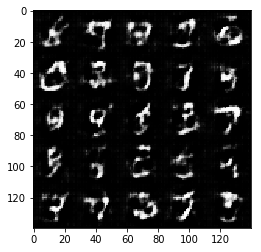

Epoch 1/2 Step 300... Discriminator Loss: 1.6699... Generator Loss: 0.3980
Epoch 1/2 Step 400... Discriminator Loss: 2.3718... Generator Loss: 1.7699
(5, 5, 28, 28, 1)
(5, 5, 28, 28)


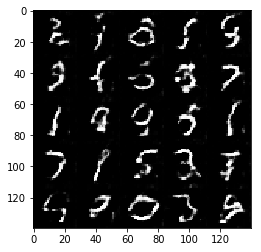

Epoch 1/2 Step 500... Discriminator Loss: 1.4476... Generator Loss: 0.5760
Epoch 1/2 Step 600... Discriminator Loss: 1.4603... Generator Loss: 0.4867
(5, 5, 28, 28, 1)
(5, 5, 28, 28)


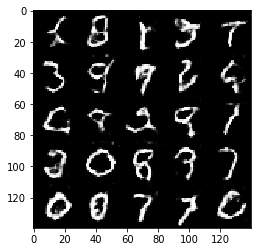

Epoch 1/2 Step 700... Discriminator Loss: 1.4167... Generator Loss: 1.0651
Epoch 1/2 Step 800... Discriminator Loss: 1.3800... Generator Loss: 0.9298
(5, 5, 28, 28, 1)
(5, 5, 28, 28)


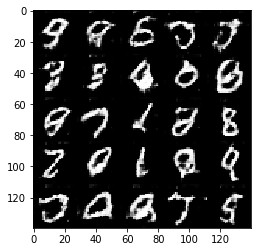

Epoch 1/2 Step 900... Discriminator Loss: 1.1896... Generator Loss: 1.2833
Epoch 2/2 Step 1000... Discriminator Loss: 1.2637... Generator Loss: 0.9017
(5, 5, 28, 28, 1)
(5, 5, 28, 28)


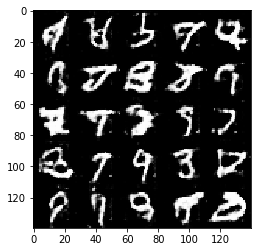

Epoch 2/2 Step 1100... Discriminator Loss: 1.1851... Generator Loss: 0.7992
Epoch 2/2 Step 1200... Discriminator Loss: 1.1586... Generator Loss: 0.6929
(5, 5, 28, 28, 1)
(5, 5, 28, 28)


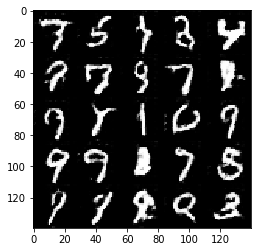

Epoch 2/2 Step 1300... Discriminator Loss: 1.1825... Generator Loss: 1.2494
Epoch 2/2 Step 1400... Discriminator Loss: 1.7624... Generator Loss: 0.3307
(5, 5, 28, 28, 1)
(5, 5, 28, 28)


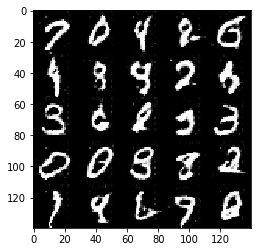

Epoch 2/2 Step 1500... Discriminator Loss: 1.3746... Generator Loss: 0.4912
Epoch 2/2 Step 1600... Discriminator Loss: 1.1235... Generator Loss: 0.7973
(5, 5, 28, 28, 1)
(5, 5, 28, 28)


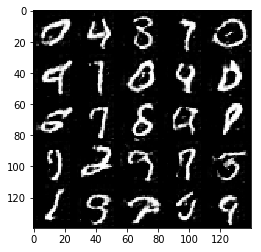

Epoch 2/2 Step 1700... Discriminator Loss: 1.2745... Generator Loss: 0.6061
Epoch 2/2 Step 1800... Discriminator Loss: 1.0375... Generator Loss: 0.9536
(5, 5, 28, 28, 1)
(5, 5, 28, 28)


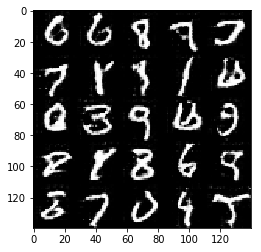

In [12]:
batch_size =64
z_dim = 100
learning_rate = 0.001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
在 CelebA 上运行你的 GANs 模型。在一般的GPU上运行每次迭代大约需要 20 分钟。你可以运行整个迭代，或者当 GANs 开始产生真实人脸图像时停止它。

Epoch 1/10 Step 100... Discriminator Loss: 2.1692... Generator Loss: 0.5152
Epoch 1/10 Step 200... Discriminator Loss: 1.4919... Generator Loss: 0.7100


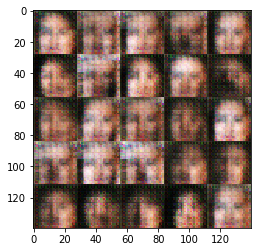

Epoch 1/10 Step 300... Discriminator Loss: 1.4729... Generator Loss: 0.6712
Epoch 1/10 Step 400... Discriminator Loss: 1.8529... Generator Loss: 0.5360


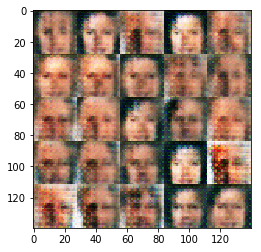

Epoch 1/10 Step 500... Discriminator Loss: 1.6049... Generator Loss: 0.6604
Epoch 1/10 Step 600... Discriminator Loss: 1.6018... Generator Loss: 0.6944


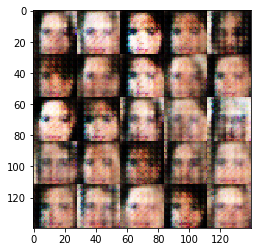

Epoch 1/10 Step 700... Discriminator Loss: 1.7420... Generator Loss: 0.5587
Epoch 1/10 Step 800... Discriminator Loss: 1.4481... Generator Loss: 0.6428


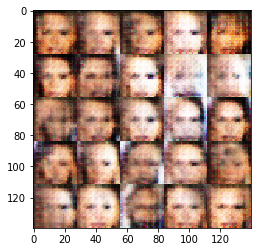

Epoch 1/10 Step 900... Discriminator Loss: 1.5313... Generator Loss: 0.7696
Epoch 1/10 Step 1000... Discriminator Loss: 1.6120... Generator Loss: 0.6685


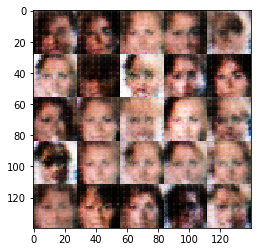

Epoch 1/10 Step 1100... Discriminator Loss: 1.3855... Generator Loss: 0.8233
Epoch 1/10 Step 1200... Discriminator Loss: 1.5340... Generator Loss: 0.6298


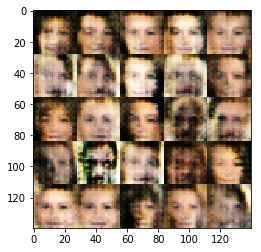

Epoch 1/10 Step 1300... Discriminator Loss: 1.6163... Generator Loss: 0.6196
Epoch 1/10 Step 1400... Discriminator Loss: 1.4959... Generator Loss: 0.6638


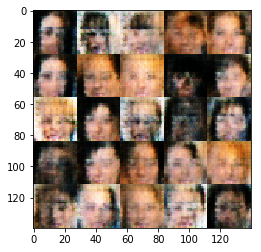

Epoch 1/10 Step 1500... Discriminator Loss: 1.5255... Generator Loss: 0.7188
Epoch 1/10 Step 1600... Discriminator Loss: 1.4823... Generator Loss: 0.6361


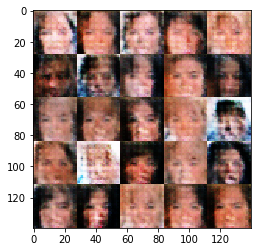

Epoch 1/10 Step 1700... Discriminator Loss: 1.3952... Generator Loss: 0.8319
Epoch 1/10 Step 1800... Discriminator Loss: 1.4362... Generator Loss: 0.7478


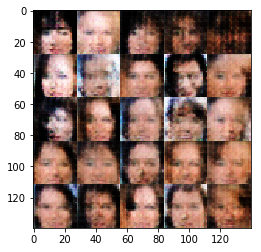

Epoch 1/10 Step 1900... Discriminator Loss: 1.4459... Generator Loss: 0.8181
Epoch 1/10 Step 2000... Discriminator Loss: 1.4982... Generator Loss: 0.7983


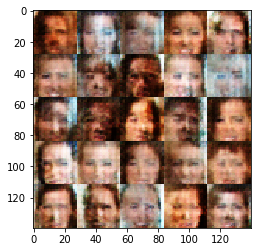

Epoch 1/10 Step 2100... Discriminator Loss: 1.4000... Generator Loss: 0.7502
Epoch 1/10 Step 2200... Discriminator Loss: 1.3781... Generator Loss: 0.6384


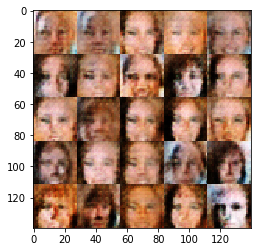

Epoch 1/10 Step 2300... Discriminator Loss: 1.5730... Generator Loss: 0.5907
Epoch 1/10 Step 2400... Discriminator Loss: 1.4870... Generator Loss: 0.7742


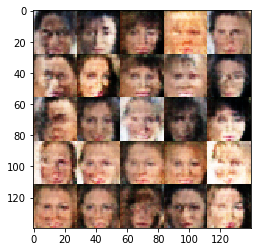

Epoch 1/10 Step 2500... Discriminator Loss: 1.3901... Generator Loss: 0.7019
Epoch 1/10 Step 2600... Discriminator Loss: 1.3845... Generator Loss: 0.7902


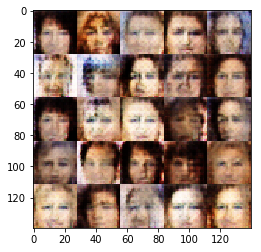

Epoch 1/10 Step 2700... Discriminator Loss: 1.4632... Generator Loss: 0.7574
Epoch 1/10 Step 2800... Discriminator Loss: 1.4200... Generator Loss: 0.7791


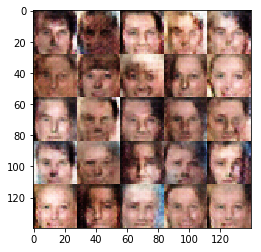

Epoch 1/10 Step 2900... Discriminator Loss: 1.4197... Generator Loss: 0.6715
Epoch 1/10 Step 3000... Discriminator Loss: 1.4869... Generator Loss: 0.6608


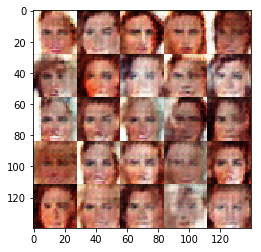

Epoch 1/10 Step 3100... Discriminator Loss: 1.4280... Generator Loss: 0.7978
Epoch 1/10 Step 3200... Discriminator Loss: 1.4587... Generator Loss: 0.7812


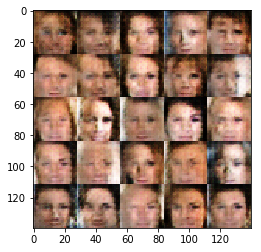

Epoch 1/10 Step 3300... Discriminator Loss: 1.3946... Generator Loss: 0.7124
Epoch 1/10 Step 3400... Discriminator Loss: 1.3829... Generator Loss: 0.7891


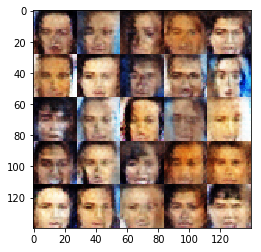

Epoch 1/10 Step 3500... Discriminator Loss: 1.4250... Generator Loss: 0.7256
Epoch 1/10 Step 3600... Discriminator Loss: 1.4629... Generator Loss: 0.6456


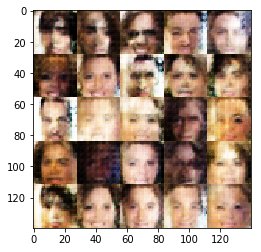

Epoch 1/10 Step 3700... Discriminator Loss: 1.4076... Generator Loss: 0.9712
Epoch 1/10 Step 3800... Discriminator Loss: 1.4105... Generator Loss: 0.6762


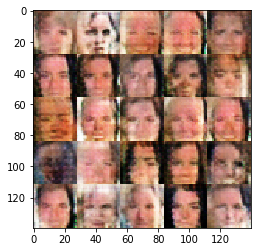

Epoch 1/10 Step 3900... Discriminator Loss: 1.3785... Generator Loss: 0.7639
Epoch 1/10 Step 4000... Discriminator Loss: 1.4148... Generator Loss: 0.6662


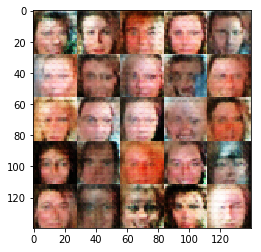

Epoch 1/10 Step 4100... Discriminator Loss: 1.4248... Generator Loss: 0.7745
Epoch 1/10 Step 4200... Discriminator Loss: 1.3969... Generator Loss: 0.7977


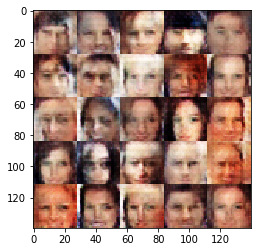

Epoch 1/10 Step 4300... Discriminator Loss: 1.4322... Generator Loss: 0.6751
Epoch 1/10 Step 4400... Discriminator Loss: 1.4102... Generator Loss: 0.6866


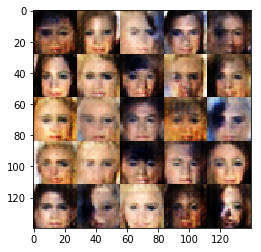

Epoch 1/10 Step 4500... Discriminator Loss: 1.4276... Generator Loss: 0.6086
Epoch 1/10 Step 4600... Discriminator Loss: 1.3796... Generator Loss: 0.7369


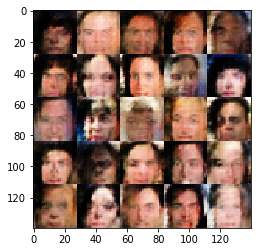

Epoch 1/10 Step 4700... Discriminator Loss: 1.3636... Generator Loss: 0.8505
Epoch 1/10 Step 4800... Discriminator Loss: 1.3837... Generator Loss: 0.7753


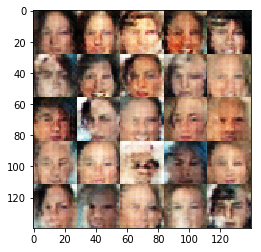

Epoch 1/10 Step 4900... Discriminator Loss: 1.4352... Generator Loss: 0.8950
Epoch 1/10 Step 5000... Discriminator Loss: 1.4253... Generator Loss: 0.8330


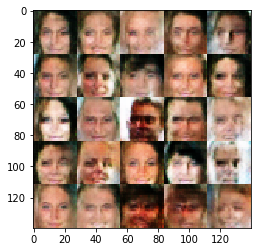

Epoch 1/10 Step 5100... Discriminator Loss: 1.4136... Generator Loss: 0.7397
Epoch 1/10 Step 5200... Discriminator Loss: 1.4330... Generator Loss: 0.8528


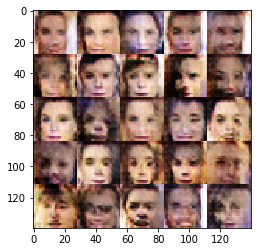

Epoch 1/10 Step 5300... Discriminator Loss: 1.4045... Generator Loss: 0.7919
Epoch 1/10 Step 5400... Discriminator Loss: 1.4054... Generator Loss: 0.7178


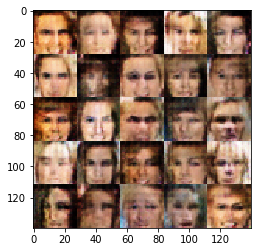

Epoch 1/10 Step 5500... Discriminator Loss: 1.4337... Generator Loss: 0.8522
Epoch 1/10 Step 5600... Discriminator Loss: 1.3903... Generator Loss: 0.8115


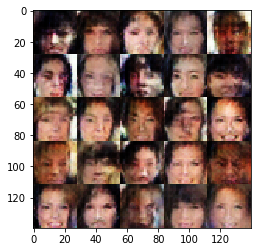

Epoch 1/10 Step 5700... Discriminator Loss: 1.3804... Generator Loss: 0.7549
Epoch 1/10 Step 5800... Discriminator Loss: 1.4045... Generator Loss: 0.8195


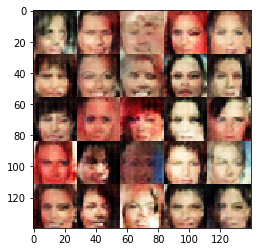

Epoch 1/10 Step 5900... Discriminator Loss: 1.3925... Generator Loss: 0.9120
Epoch 1/10 Step 6000... Discriminator Loss: 1.4020... Generator Loss: 0.8483


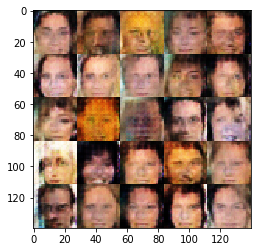

Epoch 1/10 Step 6100... Discriminator Loss: 1.3922... Generator Loss: 0.7784
Epoch 1/10 Step 6200... Discriminator Loss: 1.3907... Generator Loss: 0.7106


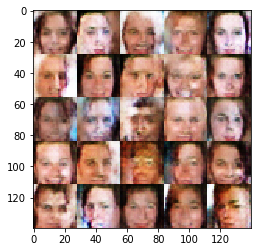

Epoch 1/10 Step 6300... Discriminator Loss: 1.3947... Generator Loss: 0.8453
Epoch 2/10 Step 6400... Discriminator Loss: 1.3935... Generator Loss: 0.7711


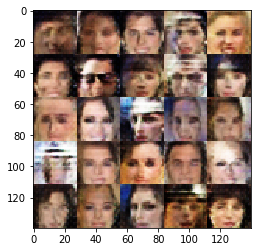

Epoch 2/10 Step 6500... Discriminator Loss: 1.4116... Generator Loss: 0.7731
Epoch 2/10 Step 6600... Discriminator Loss: 1.3882... Generator Loss: 0.7897


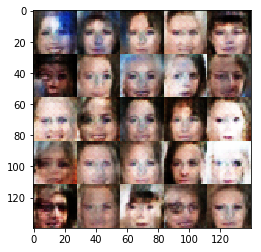

Epoch 2/10 Step 6700... Discriminator Loss: 1.3991... Generator Loss: 0.8787
Epoch 2/10 Step 6800... Discriminator Loss: 1.4462... Generator Loss: 0.7735


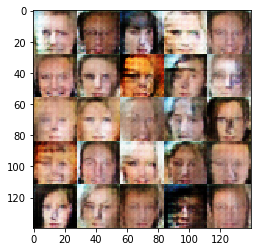

Epoch 2/10 Step 6900... Discriminator Loss: 1.4142... Generator Loss: 0.7644
Epoch 2/10 Step 7000... Discriminator Loss: 1.3758... Generator Loss: 0.8367


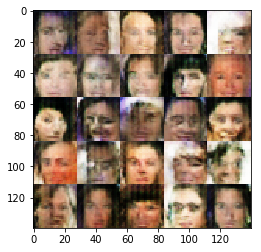

Epoch 2/10 Step 7100... Discriminator Loss: 1.3880... Generator Loss: 0.7820
Epoch 2/10 Step 7200... Discriminator Loss: 1.4204... Generator Loss: 0.8341


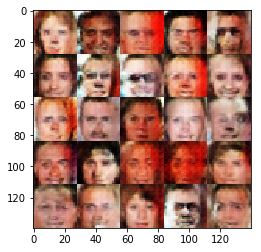

Epoch 2/10 Step 7300... Discriminator Loss: 1.3742... Generator Loss: 0.7769
Epoch 2/10 Step 7400... Discriminator Loss: 1.3696... Generator Loss: 0.8235


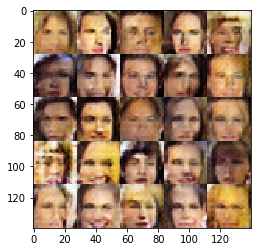

Epoch 2/10 Step 7500... Discriminator Loss: 1.4013... Generator Loss: 0.7380
Epoch 2/10 Step 7600... Discriminator Loss: 1.3982... Generator Loss: 0.7259


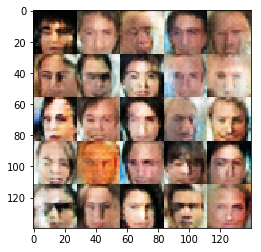

Epoch 2/10 Step 7700... Discriminator Loss: 1.3926... Generator Loss: 0.7849
Epoch 2/10 Step 7800... Discriminator Loss: 1.4543... Generator Loss: 0.6555


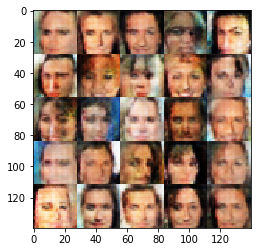

Epoch 2/10 Step 7900... Discriminator Loss: 1.3644... Generator Loss: 0.7964
Epoch 2/10 Step 8000... Discriminator Loss: 1.3921... Generator Loss: 0.7602


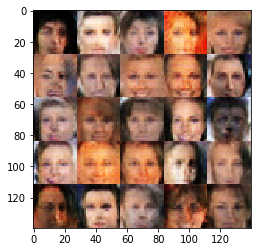

Epoch 2/10 Step 8100... Discriminator Loss: 1.3947... Generator Loss: 0.8988
Epoch 2/10 Step 8200... Discriminator Loss: 1.3862... Generator Loss: 0.7085


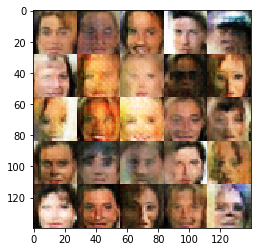

Epoch 2/10 Step 8300... Discriminator Loss: 1.3952... Generator Loss: 0.9282
Epoch 2/10 Step 8400... Discriminator Loss: 1.3887... Generator Loss: 0.7985


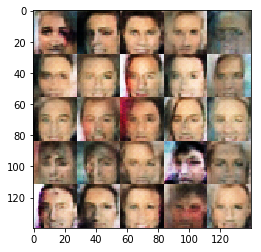

Epoch 2/10 Step 8500... Discriminator Loss: 1.3911... Generator Loss: 0.8429
Epoch 2/10 Step 8600... Discriminator Loss: 1.3868... Generator Loss: 0.8227


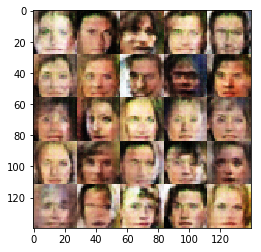

Epoch 2/10 Step 8700... Discriminator Loss: 1.3805... Generator Loss: 0.7814
Epoch 2/10 Step 8800... Discriminator Loss: 1.4001... Generator Loss: 0.7756


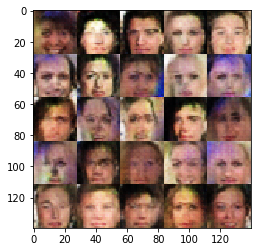

Epoch 2/10 Step 8900... Discriminator Loss: 1.3855... Generator Loss: 0.6668
Epoch 2/10 Step 9000... Discriminator Loss: 1.4007... Generator Loss: 0.7919


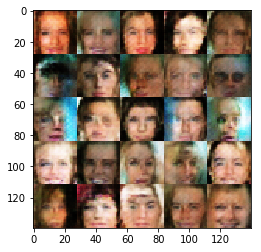

Epoch 2/10 Step 9100... Discriminator Loss: 1.3773... Generator Loss: 0.8416
Epoch 2/10 Step 9200... Discriminator Loss: 1.3857... Generator Loss: 0.7110


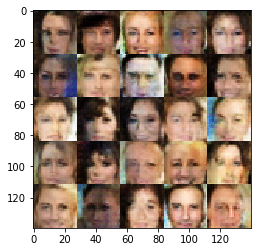

Epoch 2/10 Step 9300... Discriminator Loss: 1.3639... Generator Loss: 0.8062
Epoch 2/10 Step 9400... Discriminator Loss: 1.4021... Generator Loss: 0.8080


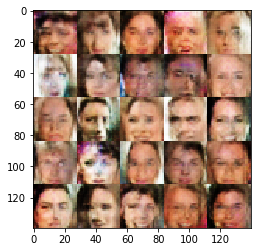

Epoch 2/10 Step 9500... Discriminator Loss: 1.3703... Generator Loss: 0.8013
Epoch 2/10 Step 9600... Discriminator Loss: 1.3948... Generator Loss: 0.7978


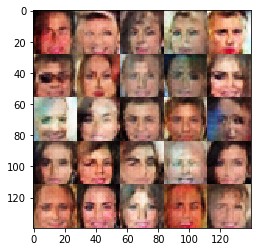

Epoch 2/10 Step 9700... Discriminator Loss: 1.3637... Generator Loss: 0.8051
Epoch 2/10 Step 9800... Discriminator Loss: 1.4301... Generator Loss: 0.8319


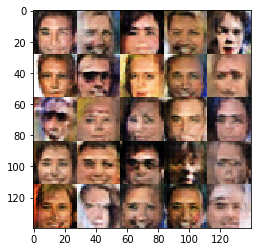

Epoch 2/10 Step 9900... Discriminator Loss: 1.3764... Generator Loss: 0.8813
Epoch 2/10 Step 10000... Discriminator Loss: 1.4270... Generator Loss: 0.7368


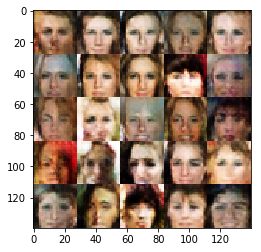

Epoch 2/10 Step 10100... Discriminator Loss: 1.3943... Generator Loss: 0.7190
Epoch 2/10 Step 10200... Discriminator Loss: 1.3786... Generator Loss: 0.7993


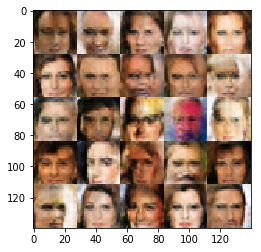

Epoch 2/10 Step 10300... Discriminator Loss: 1.3704... Generator Loss: 0.8162
Epoch 2/10 Step 10400... Discriminator Loss: 1.4119... Generator Loss: 0.7807


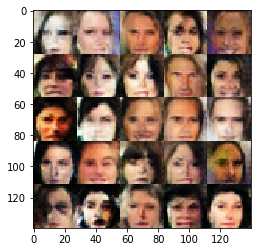

Epoch 2/10 Step 10500... Discriminator Loss: 1.4041... Generator Loss: 0.8798
Epoch 2/10 Step 10600... Discriminator Loss: 1.4350... Generator Loss: 0.8014


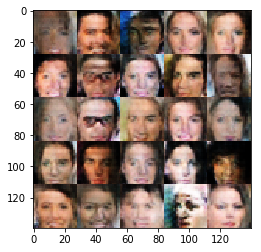

Epoch 2/10 Step 10700... Discriminator Loss: 1.3788... Generator Loss: 0.7819
Epoch 2/10 Step 10800... Discriminator Loss: 1.4040... Generator Loss: 0.7107


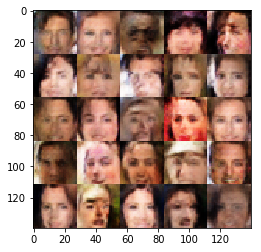

Epoch 2/10 Step 10900... Discriminator Loss: 1.4359... Generator Loss: 0.6966
Epoch 2/10 Step 11000... Discriminator Loss: 1.3970... Generator Loss: 0.7442


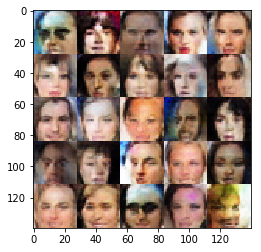

Epoch 2/10 Step 11100... Discriminator Loss: 1.3748... Generator Loss: 0.6714
Epoch 2/10 Step 11200... Discriminator Loss: 1.4445... Generator Loss: 0.8907


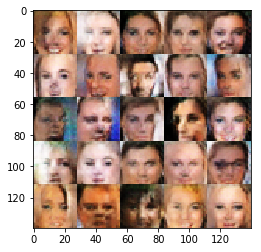

Epoch 2/10 Step 11300... Discriminator Loss: 1.3913... Generator Loss: 0.7186
Epoch 2/10 Step 11400... Discriminator Loss: 1.4233... Generator Loss: 0.6763


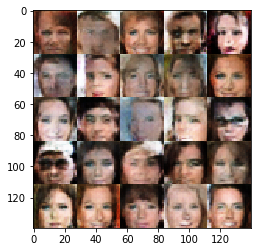

Epoch 2/10 Step 11500... Discriminator Loss: 1.3980... Generator Loss: 0.7866
Epoch 2/10 Step 11600... Discriminator Loss: 1.3616... Generator Loss: 0.7102


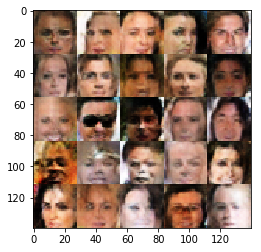

Epoch 2/10 Step 11700... Discriminator Loss: 1.3344... Generator Loss: 0.7988
Epoch 2/10 Step 11800... Discriminator Loss: 1.4011... Generator Loss: 0.6801


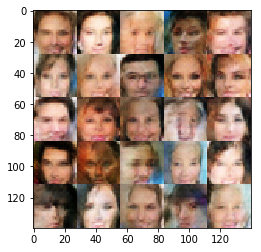

Epoch 2/10 Step 11900... Discriminator Loss: 1.4234... Generator Loss: 0.8056
Epoch 2/10 Step 12000... Discriminator Loss: 1.3679... Generator Loss: 0.7055


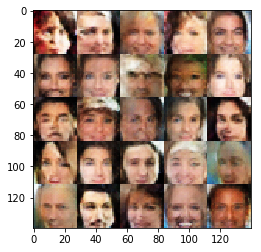

Epoch 2/10 Step 12100... Discriminator Loss: 1.3876... Generator Loss: 0.6468
Epoch 2/10 Step 12200... Discriminator Loss: 1.3922... Generator Loss: 0.8169


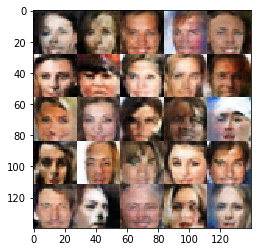

Epoch 2/10 Step 12300... Discriminator Loss: 1.4794... Generator Loss: 0.6366
Epoch 2/10 Step 12400... Discriminator Loss: 1.5221... Generator Loss: 0.5288


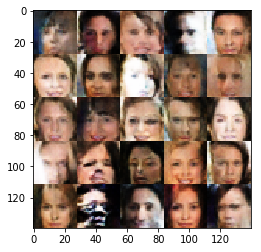

Epoch 2/10 Step 12500... Discriminator Loss: 1.4309... Generator Loss: 0.7182
Epoch 2/10 Step 12600... Discriminator Loss: 1.3917... Generator Loss: 0.9844


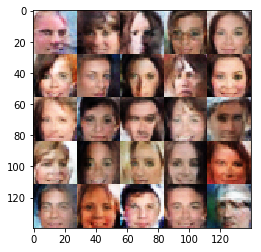

Epoch 3/10 Step 12700... Discriminator Loss: 1.4099... Generator Loss: 0.7536
Epoch 3/10 Step 12800... Discriminator Loss: 1.3418... Generator Loss: 0.6723


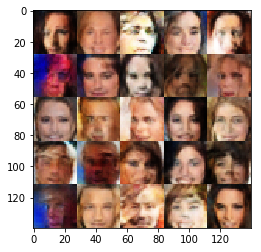

Epoch 3/10 Step 12900... Discriminator Loss: 1.4254... Generator Loss: 0.7606
Epoch 3/10 Step 13000... Discriminator Loss: 1.4587... Generator Loss: 0.5599


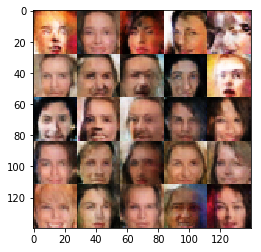

Epoch 3/10 Step 13100... Discriminator Loss: 1.4205... Generator Loss: 0.7268
Epoch 3/10 Step 13200... Discriminator Loss: 1.4916... Generator Loss: 0.6429


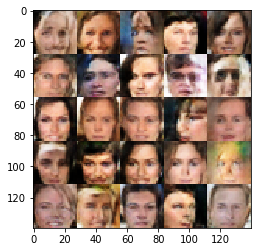

Epoch 3/10 Step 13300... Discriminator Loss: 1.4364... Generator Loss: 0.6751
Epoch 3/10 Step 13400... Discriminator Loss: 1.4360... Generator Loss: 0.7380


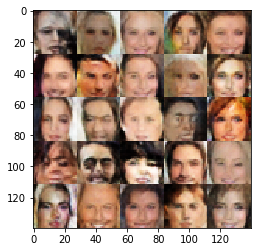

Epoch 3/10 Step 13500... Discriminator Loss: 1.2776... Generator Loss: 0.7349
Epoch 3/10 Step 13600... Discriminator Loss: 1.4832... Generator Loss: 0.5728


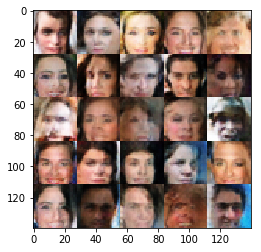

Epoch 3/10 Step 13700... Discriminator Loss: 1.6125... Generator Loss: 0.5695
Epoch 3/10 Step 13800... Discriminator Loss: 1.3521... Generator Loss: 0.6308


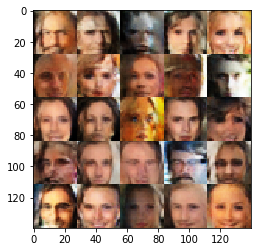

Epoch 3/10 Step 13900... Discriminator Loss: 1.4501... Generator Loss: 0.6554
Epoch 3/10 Step 14000... Discriminator Loss: 1.4680... Generator Loss: 0.5436


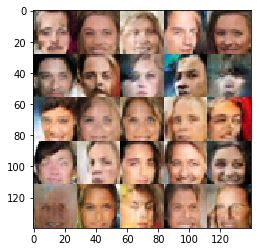

Epoch 3/10 Step 14100... Discriminator Loss: 1.4118... Generator Loss: 0.5888
Epoch 3/10 Step 14200... Discriminator Loss: 1.6766... Generator Loss: 0.3866


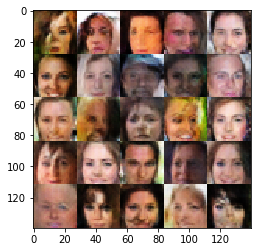

Epoch 3/10 Step 14300... Discriminator Loss: 1.5562... Generator Loss: 0.5489
Epoch 3/10 Step 14400... Discriminator Loss: 1.3883... Generator Loss: 0.6123


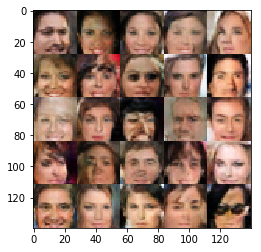

Epoch 3/10 Step 14500... Discriminator Loss: 1.2752... Generator Loss: 0.8887
Epoch 3/10 Step 14600... Discriminator Loss: 1.3345... Generator Loss: 0.6709


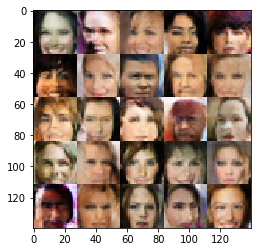

Epoch 3/10 Step 14700... Discriminator Loss: 1.1577... Generator Loss: 0.7902
Epoch 3/10 Step 14800... Discriminator Loss: 1.4459... Generator Loss: 0.5877


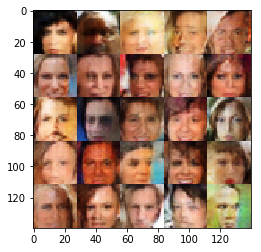

Epoch 3/10 Step 14900... Discriminator Loss: 1.3353... Generator Loss: 0.6177
Epoch 3/10 Step 15000... Discriminator Loss: 1.3370... Generator Loss: 0.8140


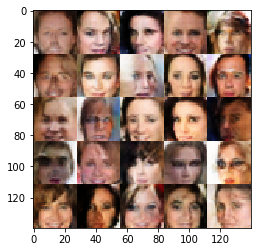

Epoch 3/10 Step 15100... Discriminator Loss: 1.5037... Generator Loss: 0.6649
Epoch 3/10 Step 15200... Discriminator Loss: 1.2917... Generator Loss: 0.7771


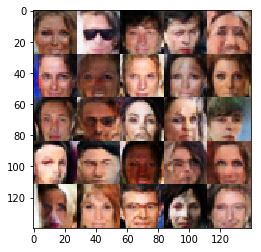

Epoch 3/10 Step 15300... Discriminator Loss: 1.5318... Generator Loss: 0.5055
Epoch 3/10 Step 15400... Discriminator Loss: 1.4901... Generator Loss: 0.6513


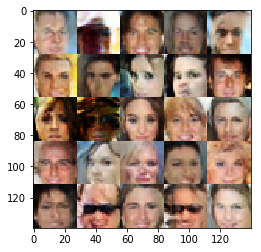

Epoch 3/10 Step 15500... Discriminator Loss: 1.3802... Generator Loss: 0.6460
Epoch 3/10 Step 15600... Discriminator Loss: 1.1571... Generator Loss: 0.8978


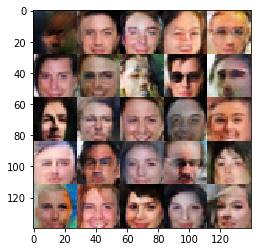

Epoch 3/10 Step 15700... Discriminator Loss: 1.2681... Generator Loss: 0.7967
Epoch 3/10 Step 15800... Discriminator Loss: 1.2756... Generator Loss: 0.7979


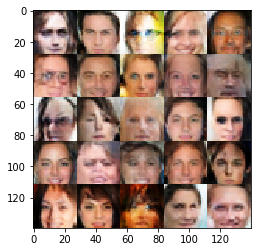

Epoch 3/10 Step 15900... Discriminator Loss: 1.3702... Generator Loss: 0.9993
Epoch 3/10 Step 16000... Discriminator Loss: 1.4690... Generator Loss: 0.5285


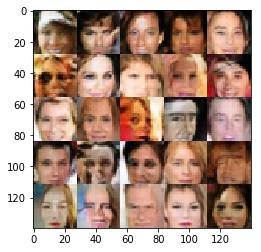

Epoch 3/10 Step 16100... Discriminator Loss: 1.9647... Generator Loss: 0.3254
Epoch 3/10 Step 16200... Discriminator Loss: 1.5202... Generator Loss: 0.5552


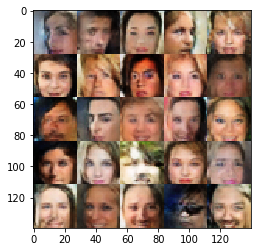

Epoch 3/10 Step 16300... Discriminator Loss: 1.5107... Generator Loss: 0.4806
Epoch 3/10 Step 16400... Discriminator Loss: 1.3816... Generator Loss: 0.7374


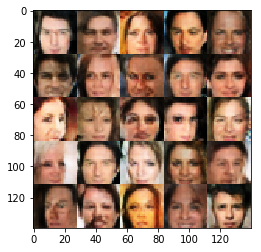

Epoch 3/10 Step 16500... Discriminator Loss: 1.3225... Generator Loss: 0.8095
Epoch 3/10 Step 16600... Discriminator Loss: 1.5826... Generator Loss: 0.4454


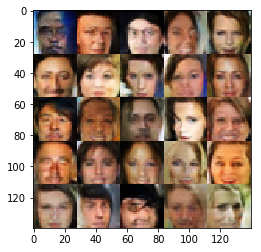

Epoch 3/10 Step 16700... Discriminator Loss: 1.1697... Generator Loss: 0.8625
Epoch 3/10 Step 16800... Discriminator Loss: 1.5026... Generator Loss: 0.5174


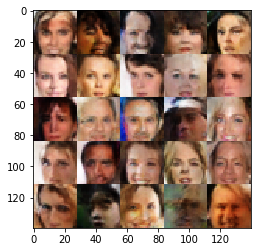

Epoch 3/10 Step 16900... Discriminator Loss: 1.3484... Generator Loss: 0.8289
Epoch 3/10 Step 17000... Discriminator Loss: 1.5791... Generator Loss: 0.4385


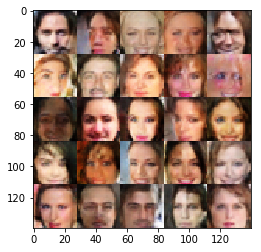

Epoch 3/10 Step 17100... Discriminator Loss: 1.3168... Generator Loss: 0.7664
Epoch 3/10 Step 17200... Discriminator Loss: 1.5248... Generator Loss: 0.4493


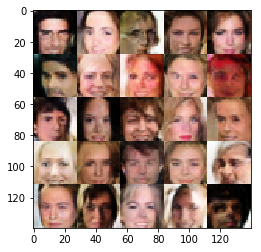

Epoch 3/10 Step 17300... Discriminator Loss: 1.5767... Generator Loss: 0.5995
Epoch 3/10 Step 17400... Discriminator Loss: 1.5499... Generator Loss: 0.4517


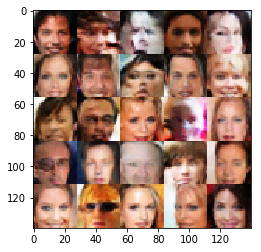

Epoch 3/10 Step 17500... Discriminator Loss: 1.4381... Generator Loss: 0.5671
Epoch 3/10 Step 17600... Discriminator Loss: 1.4058... Generator Loss: 0.6000


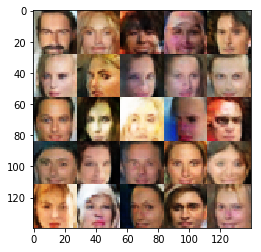

Epoch 3/10 Step 17700... Discriminator Loss: 1.3946... Generator Loss: 0.5916
Epoch 3/10 Step 17800... Discriminator Loss: 1.6265... Generator Loss: 0.4340


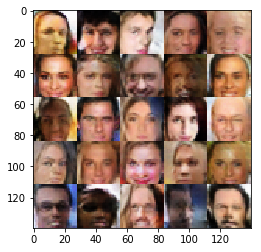

Epoch 3/10 Step 17900... Discriminator Loss: 1.3763... Generator Loss: 0.6284
Epoch 3/10 Step 18000... Discriminator Loss: 1.1695... Generator Loss: 0.8817


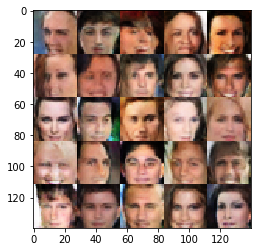

Epoch 3/10 Step 18100... Discriminator Loss: 1.2916... Generator Loss: 0.7161
Epoch 3/10 Step 18200... Discriminator Loss: 1.2901... Generator Loss: 0.7143


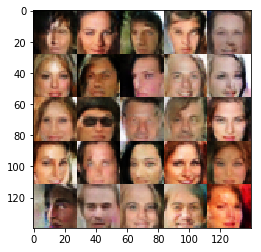

Epoch 3/10 Step 18300... Discriminator Loss: 1.4956... Generator Loss: 0.5137
Epoch 3/10 Step 18400... Discriminator Loss: 1.1278... Generator Loss: 0.8153


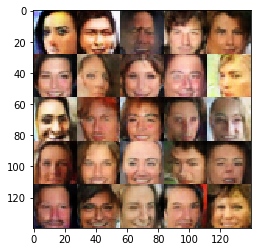

Epoch 3/10 Step 18500... Discriminator Loss: 1.3632... Generator Loss: 0.6321
Epoch 3/10 Step 18600... Discriminator Loss: 1.9173... Generator Loss: 0.2829


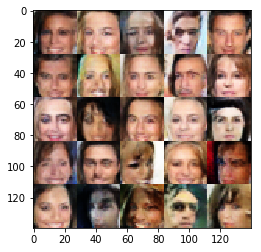

Epoch 3/10 Step 18700... Discriminator Loss: 1.3322... Generator Loss: 0.8516
Epoch 3/10 Step 18800... Discriminator Loss: 1.5057... Generator Loss: 0.6028


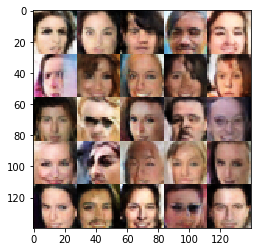

Epoch 3/10 Step 18900... Discriminator Loss: 1.4592... Generator Loss: 0.6087
Epoch 4/10 Step 19000... Discriminator Loss: 1.4645... Generator Loss: 0.9214


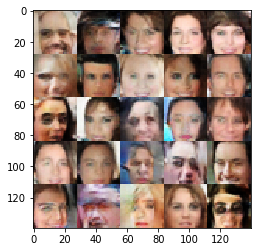

Epoch 4/10 Step 19100... Discriminator Loss: 1.1834... Generator Loss: 0.7449
Epoch 4/10 Step 19200... Discriminator Loss: 1.3877... Generator Loss: 0.7232


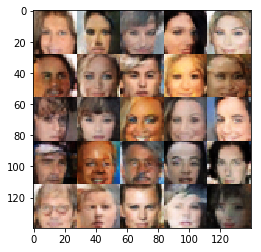

Epoch 4/10 Step 19300... Discriminator Loss: 1.3815... Generator Loss: 0.5107
Epoch 4/10 Step 19400... Discriminator Loss: 1.5453... Generator Loss: 0.4674


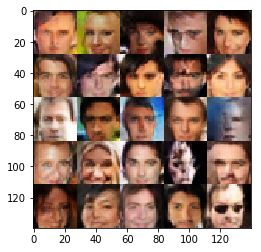

Epoch 4/10 Step 19500... Discriminator Loss: 1.2913... Generator Loss: 0.7626
Epoch 4/10 Step 19600... Discriminator Loss: 1.6186... Generator Loss: 0.5513


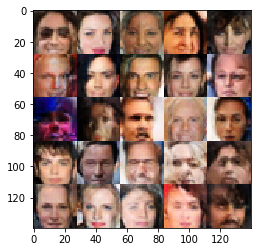

Epoch 4/10 Step 19700... Discriminator Loss: 1.3311... Generator Loss: 0.6223
Epoch 4/10 Step 19800... Discriminator Loss: 1.1637... Generator Loss: 1.4144


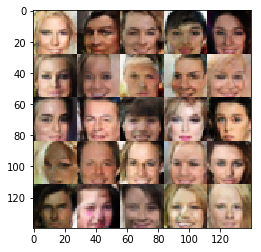

Epoch 4/10 Step 19900... Discriminator Loss: 2.0556... Generator Loss: 0.2649
Epoch 4/10 Step 20000... Discriminator Loss: 1.2805... Generator Loss: 0.7204


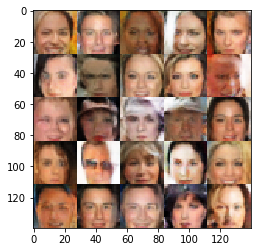

Epoch 4/10 Step 20100... Discriminator Loss: 1.5966... Generator Loss: 0.4021
Epoch 4/10 Step 20200... Discriminator Loss: 1.4499... Generator Loss: 0.5556


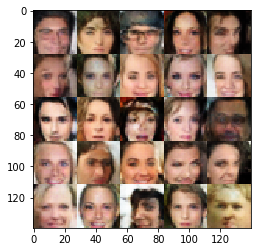

Epoch 4/10 Step 20300... Discriminator Loss: 1.2878... Generator Loss: 0.6402
Epoch 4/10 Step 20400... Discriminator Loss: 1.3307... Generator Loss: 0.6261


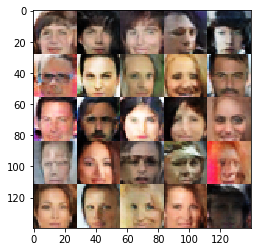

Epoch 4/10 Step 20500... Discriminator Loss: 1.5395... Generator Loss: 0.6187
Epoch 4/10 Step 20600... Discriminator Loss: 1.0406... Generator Loss: 1.0359


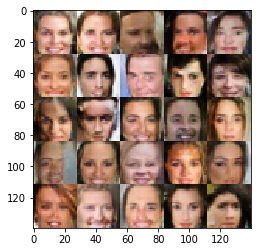

Epoch 4/10 Step 20700... Discriminator Loss: 1.0413... Generator Loss: 0.9877
Epoch 4/10 Step 20800... Discriminator Loss: 1.4098... Generator Loss: 0.6184


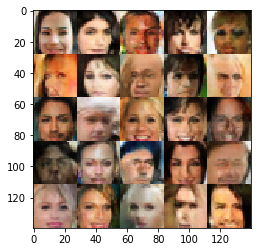

Epoch 4/10 Step 20900... Discriminator Loss: 1.6385... Generator Loss: 0.5369
Epoch 4/10 Step 21000... Discriminator Loss: 0.9449... Generator Loss: 1.0655


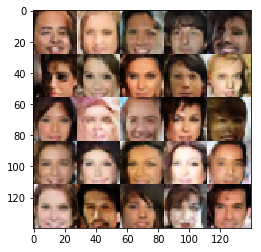

Epoch 4/10 Step 21100... Discriminator Loss: 1.4649... Generator Loss: 0.5522
Epoch 4/10 Step 21200... Discriminator Loss: 1.7174... Generator Loss: 0.3442


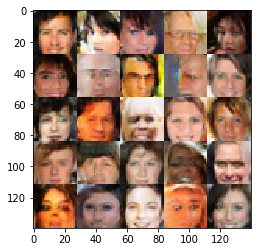

Epoch 4/10 Step 21300... Discriminator Loss: 1.4070... Generator Loss: 0.6525
Epoch 4/10 Step 21400... Discriminator Loss: 1.3273... Generator Loss: 0.8830


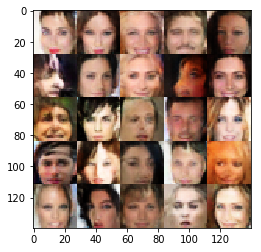

Epoch 4/10 Step 21500... Discriminator Loss: 1.7501... Generator Loss: 0.3296
Epoch 4/10 Step 21600... Discriminator Loss: 1.2924... Generator Loss: 0.5915


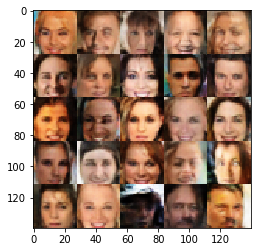

Epoch 4/10 Step 21700... Discriminator Loss: 1.4188... Generator Loss: 0.7380
Epoch 4/10 Step 21800... Discriminator Loss: 1.2325... Generator Loss: 0.7348


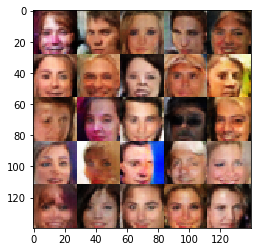

Epoch 4/10 Step 21900... Discriminator Loss: 1.4493... Generator Loss: 0.4937
Epoch 4/10 Step 22000... Discriminator Loss: 1.2492... Generator Loss: 0.7550


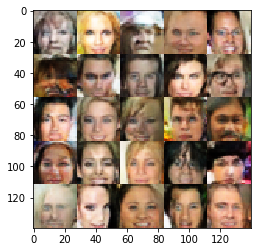

Epoch 4/10 Step 22100... Discriminator Loss: 1.4105... Generator Loss: 0.6555
Epoch 4/10 Step 22200... Discriminator Loss: 1.3445... Generator Loss: 0.6449


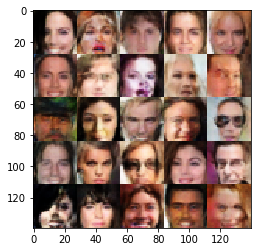

Epoch 4/10 Step 22300... Discriminator Loss: 1.7518... Generator Loss: 0.3234
Epoch 4/10 Step 22400... Discriminator Loss: 1.5695... Generator Loss: 0.4545


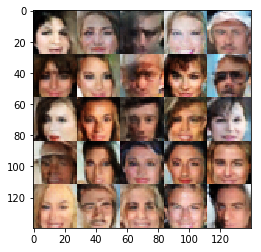

Epoch 4/10 Step 22500... Discriminator Loss: 1.0752... Generator Loss: 0.8994
Epoch 4/10 Step 22600... Discriminator Loss: 1.3714... Generator Loss: 0.6431


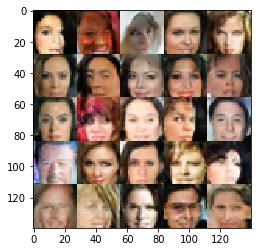

Epoch 4/10 Step 22700... Discriminator Loss: 1.3237... Generator Loss: 0.7888
Epoch 4/10 Step 22800... Discriminator Loss: 1.8479... Generator Loss: 0.3329


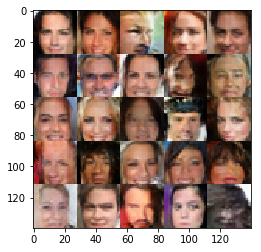

Epoch 4/10 Step 22900... Discriminator Loss: 1.9426... Generator Loss: 0.3262
Epoch 4/10 Step 23000... Discriminator Loss: 1.3830... Generator Loss: 0.5474


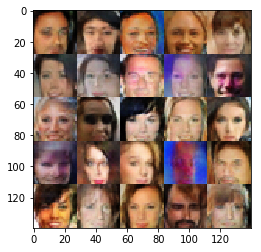

Epoch 4/10 Step 23100... Discriminator Loss: 1.4996... Generator Loss: 0.5619
Epoch 4/10 Step 23200... Discriminator Loss: 1.1620... Generator Loss: 0.9892


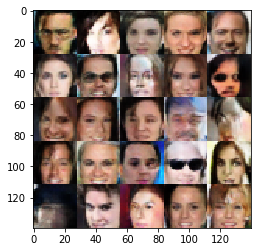

Epoch 4/10 Step 23300... Discriminator Loss: 1.3585... Generator Loss: 0.6134
Epoch 4/10 Step 23400... Discriminator Loss: 1.6232... Generator Loss: 0.3855


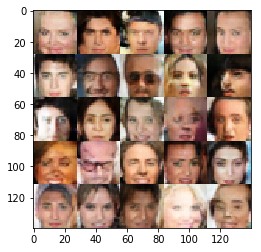

Epoch 4/10 Step 23500... Discriminator Loss: 1.1799... Generator Loss: 0.6958
Epoch 4/10 Step 23600... Discriminator Loss: 1.3339... Generator Loss: 0.5846


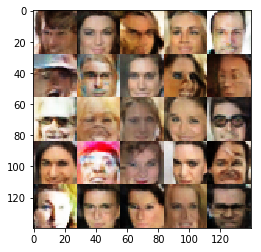

Epoch 4/10 Step 23700... Discriminator Loss: 1.7117... Generator Loss: 0.3983
Epoch 4/10 Step 23800... Discriminator Loss: 1.8238... Generator Loss: 0.3048


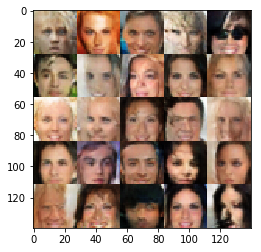

Epoch 4/10 Step 23900... Discriminator Loss: 1.2812... Generator Loss: 0.6444
Epoch 4/10 Step 24000... Discriminator Loss: 1.5515... Generator Loss: 0.4832


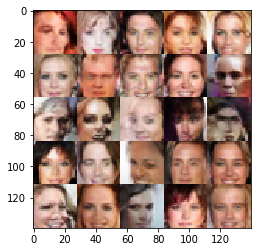

Epoch 4/10 Step 24100... Discriminator Loss: 1.2522... Generator Loss: 0.6496
Epoch 4/10 Step 24200... Discriminator Loss: 1.9847... Generator Loss: 0.2548


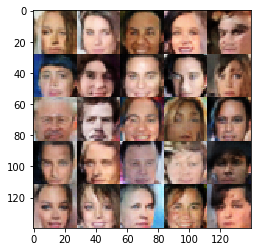

Epoch 4/10 Step 24300... Discriminator Loss: 1.3606... Generator Loss: 0.6742
Epoch 4/10 Step 24400... Discriminator Loss: 1.7205... Generator Loss: 0.3155


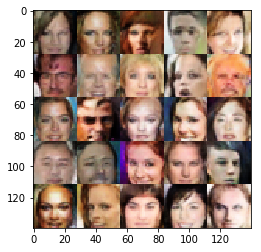

Epoch 4/10 Step 24500... Discriminator Loss: 1.5035... Generator Loss: 0.4293
Epoch 4/10 Step 24600... Discriminator Loss: 1.4747... Generator Loss: 0.4977


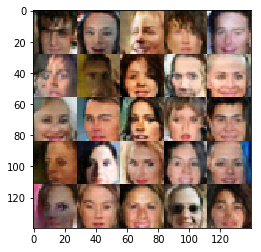

Epoch 4/10 Step 24700... Discriminator Loss: 1.6400... Generator Loss: 0.5416
Epoch 4/10 Step 24800... Discriminator Loss: 1.4852... Generator Loss: 0.5588


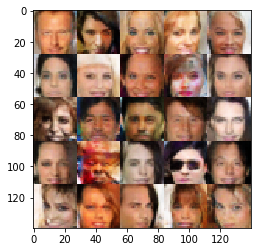

Epoch 4/10 Step 24900... Discriminator Loss: 1.1430... Generator Loss: 0.8281
Epoch 4/10 Step 25000... Discriminator Loss: 1.6673... Generator Loss: 0.3973


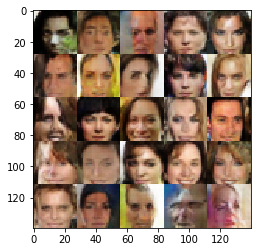

Epoch 4/10 Step 25100... Discriminator Loss: 1.2370... Generator Loss: 0.7189
Epoch 4/10 Step 25200... Discriminator Loss: 1.0537... Generator Loss: 0.9956


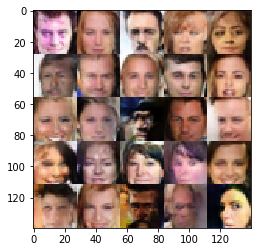

Epoch 4/10 Step 25300... Discriminator Loss: 1.8557... Generator Loss: 0.3014
Epoch 5/10 Step 25400... Discriminator Loss: 1.5647... Generator Loss: 0.5271


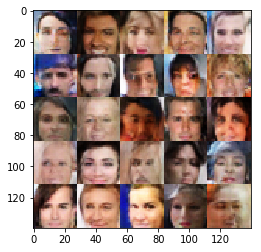

Epoch 5/10 Step 25500... Discriminator Loss: 1.2023... Generator Loss: 1.0260
Epoch 5/10 Step 25600... Discriminator Loss: 1.1634... Generator Loss: 0.8514


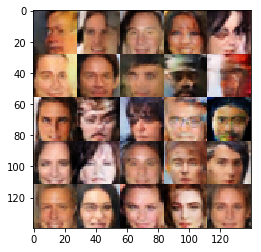

Epoch 5/10 Step 25700... Discriminator Loss: 1.4206... Generator Loss: 0.7066
Epoch 5/10 Step 25800... Discriminator Loss: 1.3250... Generator Loss: 0.6351


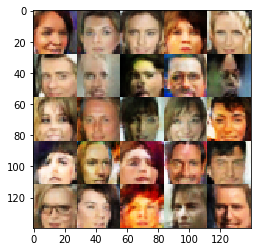

Epoch 5/10 Step 25900... Discriminator Loss: 1.7821... Generator Loss: 0.3432
Epoch 5/10 Step 26000... Discriminator Loss: 1.5253... Generator Loss: 0.4868


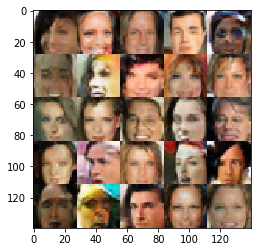

Epoch 5/10 Step 26100... Discriminator Loss: 2.0808... Generator Loss: 0.2127
Epoch 5/10 Step 26200... Discriminator Loss: 1.6311... Generator Loss: 0.3820


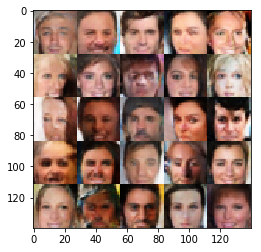

Epoch 5/10 Step 26300... Discriminator Loss: 1.5547... Generator Loss: 0.5127
Epoch 5/10 Step 26400... Discriminator Loss: 0.9382... Generator Loss: 1.0006


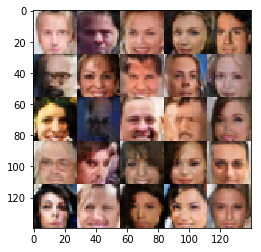

Epoch 5/10 Step 26500... Discriminator Loss: 1.2684... Generator Loss: 0.8237
Epoch 5/10 Step 26600... Discriminator Loss: 1.5393... Generator Loss: 0.4614


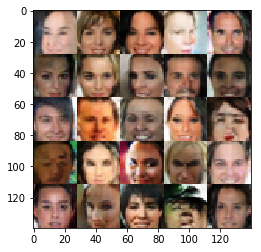

Epoch 5/10 Step 26700... Discriminator Loss: 1.1364... Generator Loss: 0.7420
Epoch 5/10 Step 26800... Discriminator Loss: 1.5096... Generator Loss: 0.4793


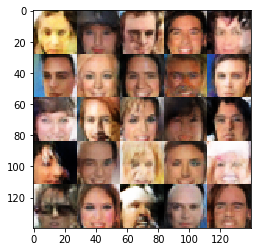

Epoch 5/10 Step 26900... Discriminator Loss: 1.8782... Generator Loss: 0.3233
Epoch 5/10 Step 27000... Discriminator Loss: 1.0878... Generator Loss: 0.8354


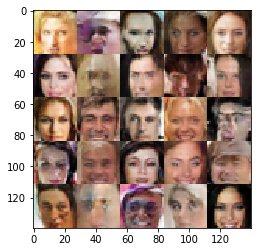

Epoch 5/10 Step 27100... Discriminator Loss: 1.5935... Generator Loss: 0.4804
Epoch 5/10 Step 27200... Discriminator Loss: 1.5360... Generator Loss: 0.4486


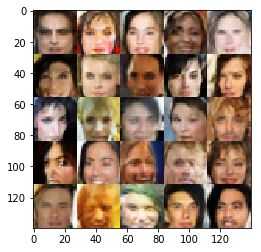

Epoch 5/10 Step 27300... Discriminator Loss: 1.2412... Generator Loss: 0.6249
Epoch 5/10 Step 27400... Discriminator Loss: 1.3625... Generator Loss: 0.5609


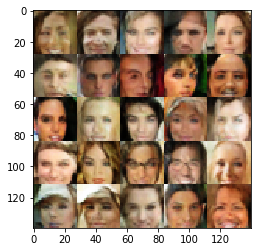

Epoch 5/10 Step 27500... Discriminator Loss: 1.2465... Generator Loss: 1.0134
Epoch 5/10 Step 27600... Discriminator Loss: 1.3946... Generator Loss: 0.5268


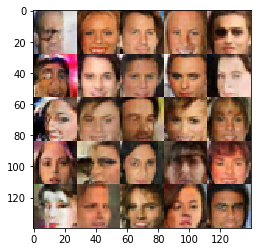

Epoch 5/10 Step 27700... Discriminator Loss: 1.5413... Generator Loss: 0.4307
Epoch 5/10 Step 27800... Discriminator Loss: 1.9222... Generator Loss: 0.2868


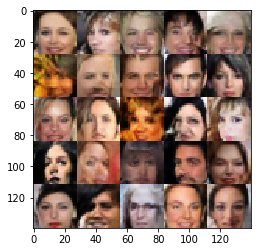

Epoch 5/10 Step 27900... Discriminator Loss: 1.1287... Generator Loss: 0.9528
Epoch 5/10 Step 28000... Discriminator Loss: 1.3440... Generator Loss: 0.5444


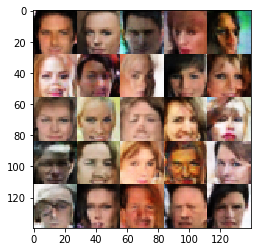

Epoch 5/10 Step 28100... Discriminator Loss: 1.4233... Generator Loss: 1.0465
Epoch 5/10 Step 28200... Discriminator Loss: 1.6026... Generator Loss: 0.4251


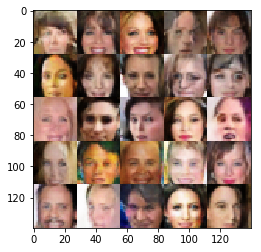

Epoch 5/10 Step 28300... Discriminator Loss: 1.7069... Generator Loss: 0.4860
Epoch 5/10 Step 28400... Discriminator Loss: 1.5509... Generator Loss: 0.5936


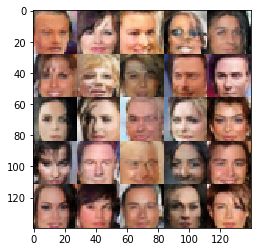

Epoch 5/10 Step 28500... Discriminator Loss: 0.8308... Generator Loss: 1.1646
Epoch 5/10 Step 28600... Discriminator Loss: 1.4636... Generator Loss: 0.5590


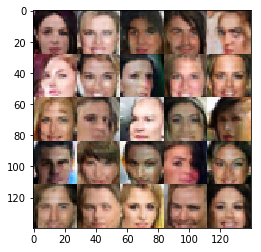

Epoch 5/10 Step 28700... Discriminator Loss: 1.8138... Generator Loss: 0.3281
Epoch 5/10 Step 28800... Discriminator Loss: 1.3046... Generator Loss: 0.6207


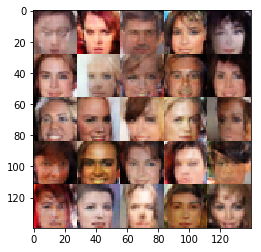

Epoch 5/10 Step 28900... Discriminator Loss: 1.3667... Generator Loss: 1.0019
Epoch 5/10 Step 29000... Discriminator Loss: 1.2666... Generator Loss: 0.6405


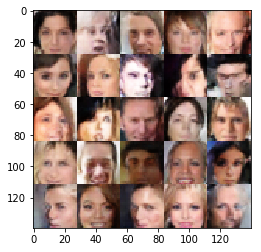

Epoch 5/10 Step 29100... Discriminator Loss: 1.2909... Generator Loss: 0.7102
Epoch 5/10 Step 29200... Discriminator Loss: 1.1970... Generator Loss: 0.7195


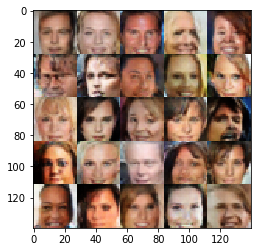

Epoch 5/10 Step 29300... Discriminator Loss: 1.4095... Generator Loss: 0.6631
Epoch 5/10 Step 29400... Discriminator Loss: 1.7661... Generator Loss: 0.3998


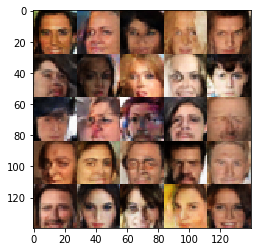

Epoch 5/10 Step 29500... Discriminator Loss: 1.8636... Generator Loss: 0.2985
Epoch 5/10 Step 29600... Discriminator Loss: 1.5018... Generator Loss: 0.4418


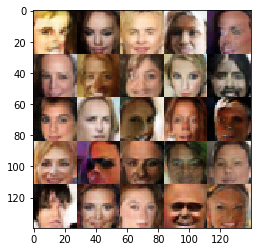

Epoch 5/10 Step 29700... Discriminator Loss: 1.8024... Generator Loss: 0.2962
Epoch 5/10 Step 29800... Discriminator Loss: 1.7926... Generator Loss: 0.3337


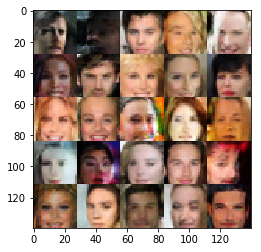

Epoch 5/10 Step 29900... Discriminator Loss: 2.0242... Generator Loss: 0.2931
Epoch 5/10 Step 30000... Discriminator Loss: 1.5099... Generator Loss: 0.6991


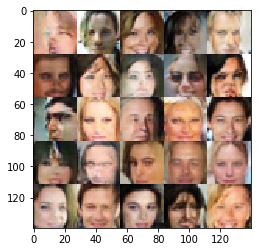

Epoch 5/10 Step 30100... Discriminator Loss: 1.4546... Generator Loss: 0.4731
Epoch 5/10 Step 30200... Discriminator Loss: 1.7495... Generator Loss: 0.3189


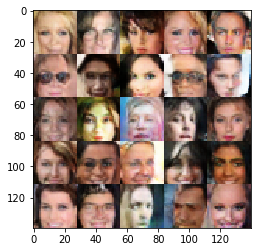

Epoch 5/10 Step 30300... Discriminator Loss: 1.9986... Generator Loss: 0.2719
Epoch 5/10 Step 30400... Discriminator Loss: 1.4846... Generator Loss: 0.5703


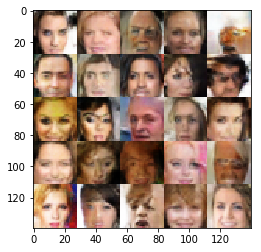

Epoch 5/10 Step 30500... Discriminator Loss: 1.2502... Generator Loss: 0.5867
Epoch 5/10 Step 30600... Discriminator Loss: 1.3713... Generator Loss: 1.3126


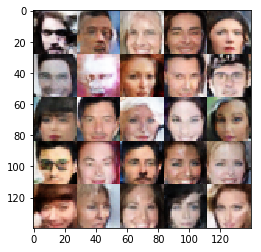

Epoch 5/10 Step 30700... Discriminator Loss: 1.7130... Generator Loss: 0.3587
Epoch 5/10 Step 30800... Discriminator Loss: 1.5016... Generator Loss: 0.4790


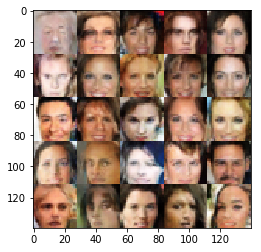

Epoch 5/10 Step 30900... Discriminator Loss: 1.4255... Generator Loss: 0.4935
Epoch 5/10 Step 31000... Discriminator Loss: 1.4564... Generator Loss: 0.4633


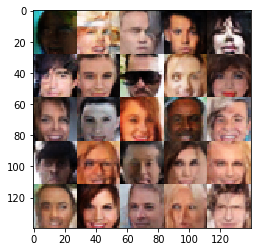

Epoch 5/10 Step 31100... Discriminator Loss: 1.2462... Generator Loss: 0.6491
Epoch 5/10 Step 31200... Discriminator Loss: 1.9201... Generator Loss: 0.2839


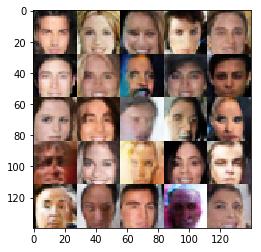

Epoch 5/10 Step 31300... Discriminator Loss: 1.2878... Generator Loss: 0.6176
Epoch 5/10 Step 31400... Discriminator Loss: 1.3299... Generator Loss: 0.5192


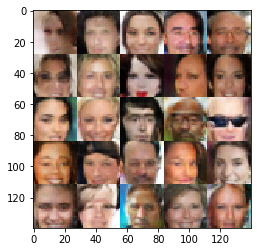

Epoch 5/10 Step 31500... Discriminator Loss: 1.5397... Generator Loss: 0.4598
Epoch 5/10 Step 31600... Discriminator Loss: 1.8193... Generator Loss: 0.3326


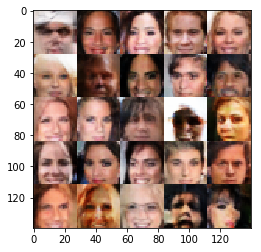

Epoch 6/10 Step 31700... Discriminator Loss: 1.7435... Generator Loss: 0.3874
Epoch 6/10 Step 31800... Discriminator Loss: 1.9574... Generator Loss: 0.2562


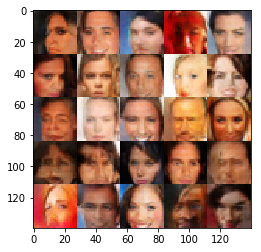

Epoch 6/10 Step 31900... Discriminator Loss: 1.3133... Generator Loss: 0.6293
Epoch 6/10 Step 32000... Discriminator Loss: 1.6179... Generator Loss: 0.4208


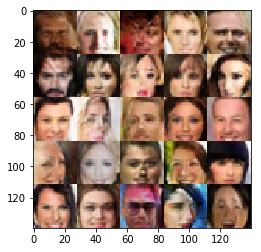

Epoch 6/10 Step 32100... Discriminator Loss: 1.7090... Generator Loss: 0.3551
Epoch 6/10 Step 32200... Discriminator Loss: 1.2814... Generator Loss: 0.7911


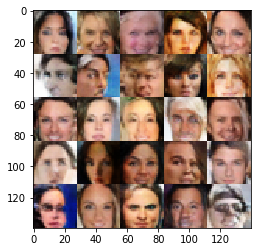

Epoch 6/10 Step 32300... Discriminator Loss: 1.7173... Generator Loss: 0.4233
Epoch 6/10 Step 32400... Discriminator Loss: 2.1004... Generator Loss: 0.2189


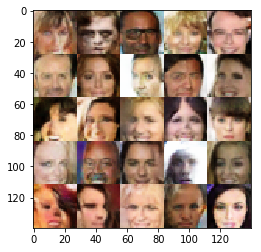

Epoch 6/10 Step 32500... Discriminator Loss: 1.0548... Generator Loss: 0.8082
Epoch 6/10 Step 32600... Discriminator Loss: 1.2111... Generator Loss: 0.6822


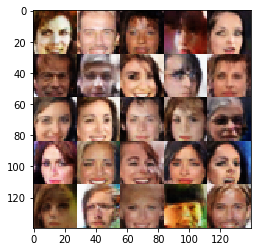

Epoch 6/10 Step 32700... Discriminator Loss: 1.3093... Generator Loss: 0.6054
Epoch 6/10 Step 32800... Discriminator Loss: 1.4840... Generator Loss: 0.4215


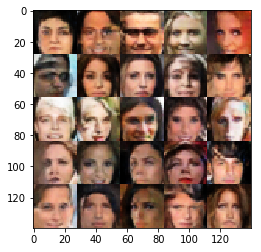

Epoch 6/10 Step 32900... Discriminator Loss: 1.3025... Generator Loss: 0.7728
Epoch 6/10 Step 33000... Discriminator Loss: 1.7306... Generator Loss: 0.9634


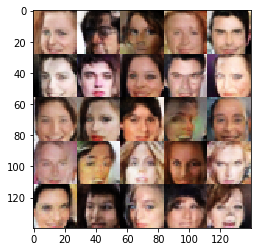

Epoch 6/10 Step 33100... Discriminator Loss: 0.9767... Generator Loss: 1.0227
Epoch 6/10 Step 33200... Discriminator Loss: 2.2231... Generator Loss: 0.1980


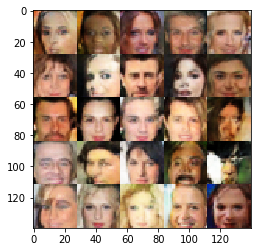

Epoch 6/10 Step 33300... Discriminator Loss: 1.6015... Generator Loss: 0.3968
Epoch 6/10 Step 33400... Discriminator Loss: 1.4557... Generator Loss: 0.4925


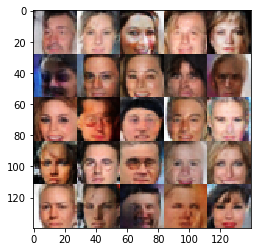

Epoch 6/10 Step 33500... Discriminator Loss: 1.4864... Generator Loss: 0.5521
Epoch 6/10 Step 33600... Discriminator Loss: 1.2083... Generator Loss: 0.7121


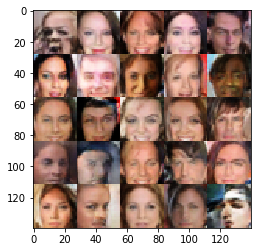

Epoch 6/10 Step 33700... Discriminator Loss: 1.6700... Generator Loss: 0.4597
Epoch 6/10 Step 33800... Discriminator Loss: 1.6117... Generator Loss: 0.4017


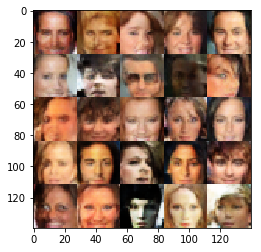

Epoch 6/10 Step 33900... Discriminator Loss: 1.2888... Generator Loss: 0.5764
Epoch 6/10 Step 34000... Discriminator Loss: 1.8631... Generator Loss: 0.3526


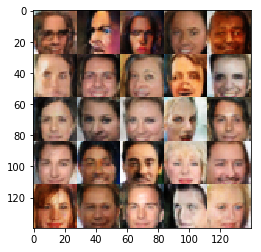

Epoch 6/10 Step 34100... Discriminator Loss: 1.7043... Generator Loss: 0.3267
Epoch 6/10 Step 34200... Discriminator Loss: 1.3235... Generator Loss: 0.5788


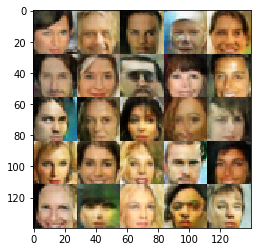

Epoch 6/10 Step 34300... Discriminator Loss: 1.3080... Generator Loss: 0.7712
Epoch 6/10 Step 34400... Discriminator Loss: 1.4282... Generator Loss: 0.4773


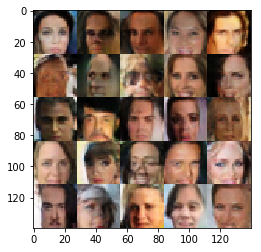

Epoch 6/10 Step 34500... Discriminator Loss: 1.4931... Generator Loss: 0.4215
Epoch 6/10 Step 34600... Discriminator Loss: 1.8353... Generator Loss: 0.3944


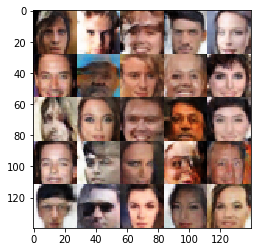

Epoch 6/10 Step 34700... Discriminator Loss: 1.6092... Generator Loss: 0.4137
Epoch 6/10 Step 34800... Discriminator Loss: 1.6742... Generator Loss: 0.6652


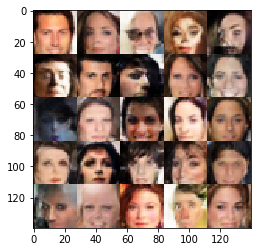

Epoch 6/10 Step 34900... Discriminator Loss: 1.7514... Generator Loss: 0.3717
Epoch 6/10 Step 35000... Discriminator Loss: 1.3052... Generator Loss: 0.6616


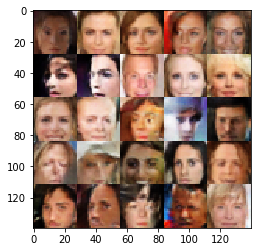

Epoch 6/10 Step 35100... Discriminator Loss: 1.8257... Generator Loss: 0.2969
Epoch 6/10 Step 35200... Discriminator Loss: 1.8207... Generator Loss: 0.3848


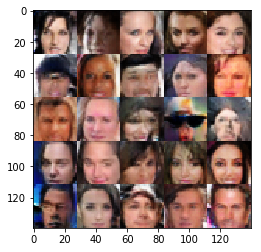

Epoch 6/10 Step 35300... Discriminator Loss: 1.1855... Generator Loss: 0.7486
Epoch 6/10 Step 35400... Discriminator Loss: 2.1356... Generator Loss: 0.2232


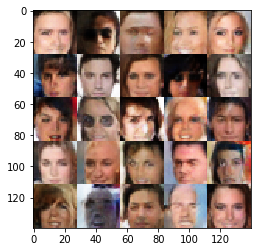

Epoch 6/10 Step 35500... Discriminator Loss: 1.4266... Generator Loss: 0.5909
Epoch 6/10 Step 35600... Discriminator Loss: 1.4197... Generator Loss: 0.5571


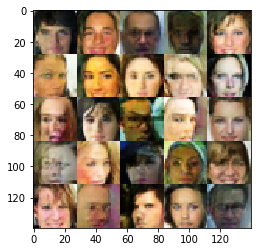

Epoch 6/10 Step 35700... Discriminator Loss: 1.4750... Generator Loss: 0.5794
Epoch 6/10 Step 35800... Discriminator Loss: 1.2625... Generator Loss: 0.5976


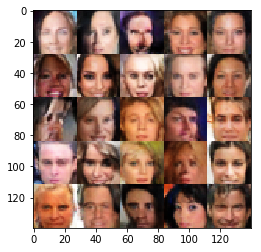

Epoch 6/10 Step 35900... Discriminator Loss: 1.5019... Generator Loss: 0.6498
Epoch 6/10 Step 36000... Discriminator Loss: 1.4467... Generator Loss: 0.5260


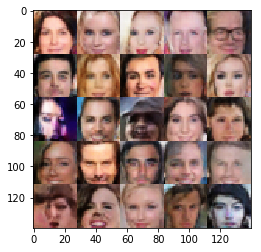

Epoch 6/10 Step 36100... Discriminator Loss: 1.5475... Generator Loss: 0.4213
Epoch 6/10 Step 36200... Discriminator Loss: 1.7081... Generator Loss: 0.3523


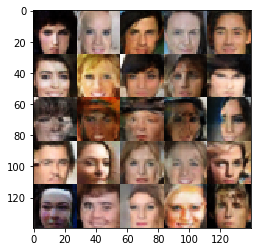

Epoch 6/10 Step 36300... Discriminator Loss: 1.5007... Generator Loss: 0.5808
Epoch 6/10 Step 36400... Discriminator Loss: 1.9125... Generator Loss: 0.2939


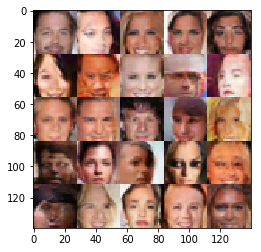

Epoch 6/10 Step 36500... Discriminator Loss: 1.6503... Generator Loss: 0.6334
Epoch 6/10 Step 36600... Discriminator Loss: 1.4272... Generator Loss: 0.6512


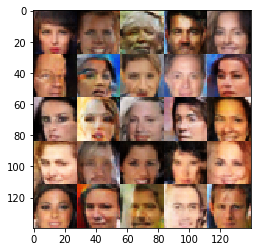

Epoch 6/10 Step 36700... Discriminator Loss: 1.3726... Generator Loss: 0.7016
Epoch 6/10 Step 36800... Discriminator Loss: 1.6024... Generator Loss: 0.3746


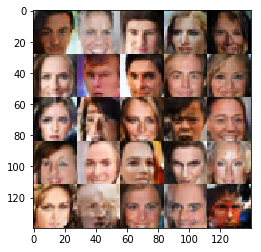

Epoch 6/10 Step 36900... Discriminator Loss: 1.0681... Generator Loss: 1.1563
Epoch 6/10 Step 37000... Discriminator Loss: 2.1345... Generator Loss: 0.2579


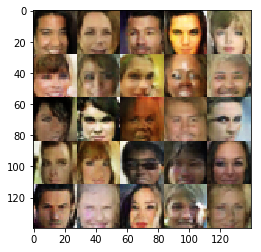

Epoch 6/10 Step 37100... Discriminator Loss: 1.9885... Generator Loss: 0.2573
Epoch 6/10 Step 37200... Discriminator Loss: 2.1619... Generator Loss: 0.1972


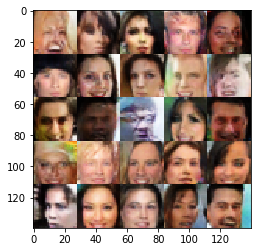

Epoch 6/10 Step 37300... Discriminator Loss: 2.0497... Generator Loss: 0.2582
Epoch 6/10 Step 37400... Discriminator Loss: 1.3712... Generator Loss: 1.2033


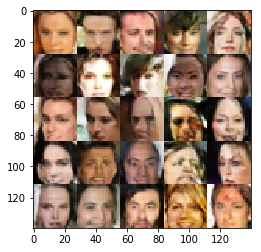

Epoch 6/10 Step 37500... Discriminator Loss: 1.9662... Generator Loss: 0.3391
Epoch 6/10 Step 37600... Discriminator Loss: 1.4892... Generator Loss: 0.5959


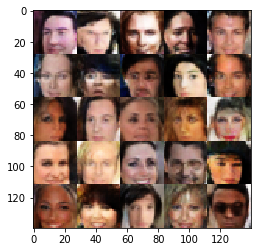

Epoch 6/10 Step 37700... Discriminator Loss: 1.5608... Generator Loss: 0.4852
Epoch 6/10 Step 37800... Discriminator Loss: 1.4955... Generator Loss: 0.4871


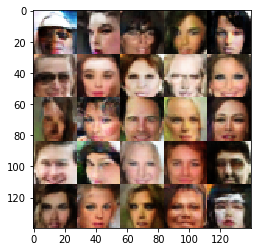

Epoch 6/10 Step 37900... Discriminator Loss: 1.5267... Generator Loss: 0.4316
Epoch 7/10 Step 38000... Discriminator Loss: 1.5636... Generator Loss: 0.3958


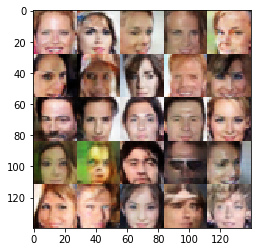

Epoch 7/10 Step 38100... Discriminator Loss: 1.3189... Generator Loss: 0.6301
Epoch 7/10 Step 38200... Discriminator Loss: 1.2193... Generator Loss: 0.7715


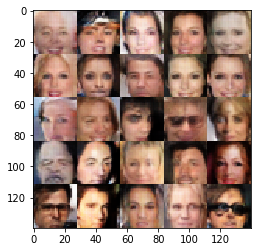

Epoch 7/10 Step 38300... Discriminator Loss: 1.4133... Generator Loss: 0.7071
Epoch 7/10 Step 38400... Discriminator Loss: 1.8399... Generator Loss: 0.3001


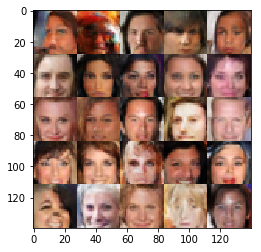

Epoch 7/10 Step 38500... Discriminator Loss: 1.4016... Generator Loss: 0.6218
Epoch 7/10 Step 38600... Discriminator Loss: 1.6668... Generator Loss: 0.3578


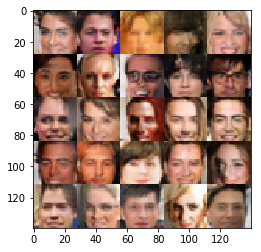

Epoch 7/10 Step 38700... Discriminator Loss: 1.9571... Generator Loss: 0.2663
Epoch 7/10 Step 38800... Discriminator Loss: 2.1613... Generator Loss: 0.2693


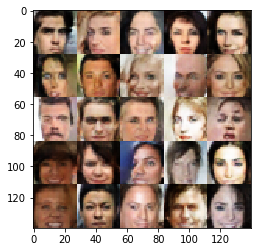

Epoch 7/10 Step 38900... Discriminator Loss: 1.6433... Generator Loss: 0.3763
Epoch 7/10 Step 39000... Discriminator Loss: 1.2008... Generator Loss: 0.8067


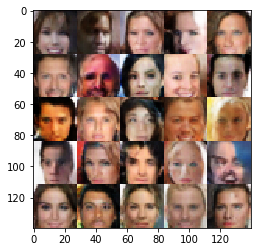

Epoch 7/10 Step 39100... Discriminator Loss: 1.8507... Generator Loss: 0.3038
Epoch 7/10 Step 39200... Discriminator Loss: 1.2229... Generator Loss: 0.7786


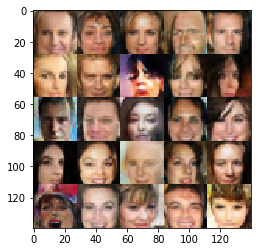

Epoch 7/10 Step 39300... Discriminator Loss: 1.5660... Generator Loss: 0.4121
Epoch 7/10 Step 39400... Discriminator Loss: 1.3096... Generator Loss: 0.7412


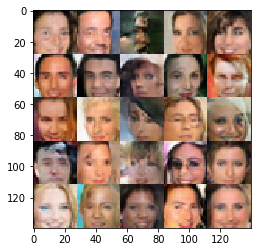

Epoch 7/10 Step 39500... Discriminator Loss: 1.9010... Generator Loss: 0.2993
Epoch 7/10 Step 39600... Discriminator Loss: 1.7349... Generator Loss: 0.3777


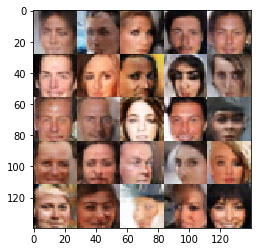

Epoch 7/10 Step 39700... Discriminator Loss: 1.7996... Generator Loss: 0.3264
Epoch 7/10 Step 39800... Discriminator Loss: 1.5224... Generator Loss: 0.4677


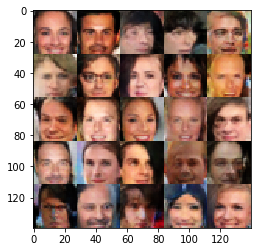

Epoch 7/10 Step 39900... Discriminator Loss: 1.2550... Generator Loss: 0.6525
Epoch 7/10 Step 40000... Discriminator Loss: 1.1267... Generator Loss: 0.6992


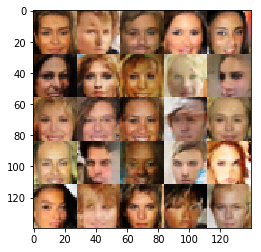

Epoch 7/10 Step 40100... Discriminator Loss: 1.1708... Generator Loss: 0.8264
Epoch 7/10 Step 40200... Discriminator Loss: 1.3866... Generator Loss: 0.9687


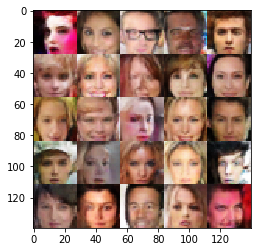

Epoch 7/10 Step 40300... Discriminator Loss: 1.8774... Generator Loss: 0.2872
Epoch 7/10 Step 40400... Discriminator Loss: 1.2021... Generator Loss: 0.7907


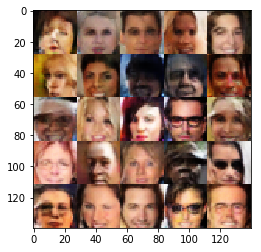

Epoch 7/10 Step 40500... Discriminator Loss: 1.5443... Generator Loss: 0.4553
Epoch 7/10 Step 40600... Discriminator Loss: 1.2960... Generator Loss: 0.6437


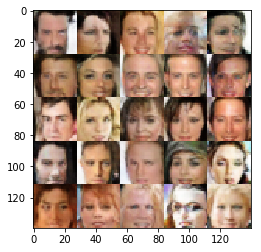

Epoch 7/10 Step 40700... Discriminator Loss: 1.4884... Generator Loss: 0.5017
Epoch 7/10 Step 40800... Discriminator Loss: 1.5860... Generator Loss: 0.4300


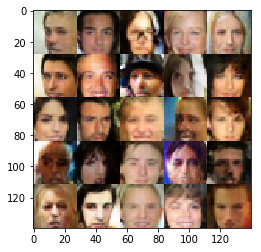

Epoch 7/10 Step 40900... Discriminator Loss: 1.3550... Generator Loss: 0.6113
Epoch 7/10 Step 41000... Discriminator Loss: 1.7783... Generator Loss: 0.3265


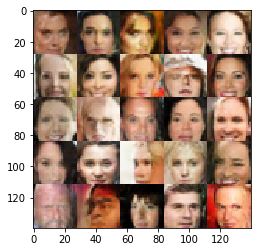

Epoch 7/10 Step 41100... Discriminator Loss: 1.9116... Generator Loss: 0.2723
Epoch 7/10 Step 41200... Discriminator Loss: 1.6016... Generator Loss: 0.4594


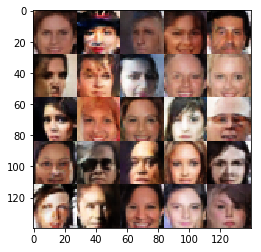

Epoch 7/10 Step 41300... Discriminator Loss: 1.9883... Generator Loss: 0.2559
Epoch 7/10 Step 41400... Discriminator Loss: 1.0456... Generator Loss: 0.9067


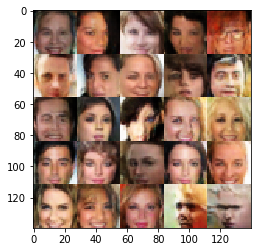

Epoch 7/10 Step 41500... Discriminator Loss: 1.5513... Generator Loss: 0.4472
Epoch 7/10 Step 41600... Discriminator Loss: 1.2610... Generator Loss: 0.6709


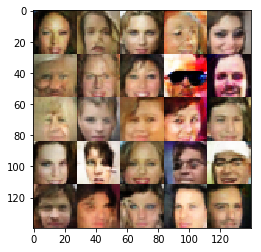

Epoch 7/10 Step 41700... Discriminator Loss: 1.3379... Generator Loss: 0.5569
Epoch 7/10 Step 41800... Discriminator Loss: 1.7068... Generator Loss: 0.3544


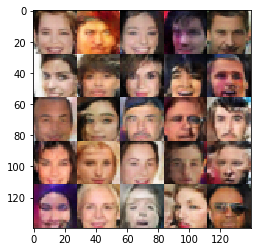

Epoch 7/10 Step 41900... Discriminator Loss: 1.5576... Generator Loss: 0.4590
Epoch 7/10 Step 42000... Discriminator Loss: 1.6449... Generator Loss: 0.4150


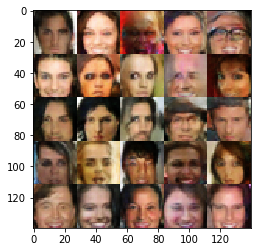

Epoch 7/10 Step 42100... Discriminator Loss: 1.0881... Generator Loss: 0.8386
Epoch 7/10 Step 42200... Discriminator Loss: 1.8711... Generator Loss: 0.3049


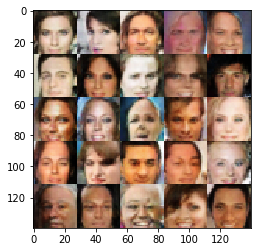

Epoch 7/10 Step 42300... Discriminator Loss: 1.8565... Generator Loss: 0.2794
Epoch 7/10 Step 42400... Discriminator Loss: 1.6765... Generator Loss: 0.4189


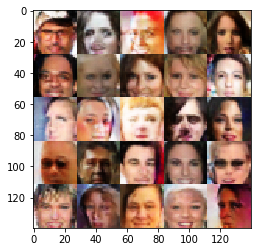

Epoch 7/10 Step 42500... Discriminator Loss: 1.9731... Generator Loss: 0.2553
Epoch 7/10 Step 42600... Discriminator Loss: 1.2245... Generator Loss: 0.7172


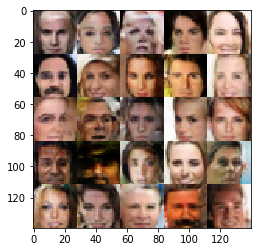

Epoch 7/10 Step 42700... Discriminator Loss: 1.6736... Generator Loss: 0.4065
Epoch 7/10 Step 42800... Discriminator Loss: 1.1494... Generator Loss: 0.8338


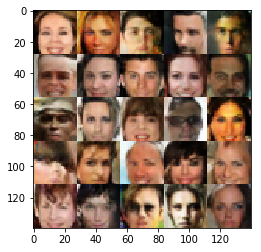

Epoch 7/10 Step 42900... Discriminator Loss: 1.5751... Generator Loss: 0.4521
Epoch 7/10 Step 43000... Discriminator Loss: 2.2152... Generator Loss: 0.2044


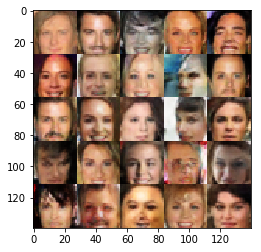

Epoch 7/10 Step 43100... Discriminator Loss: 1.2368... Generator Loss: 0.7441
Epoch 7/10 Step 43200... Discriminator Loss: 1.4769... Generator Loss: 0.9597


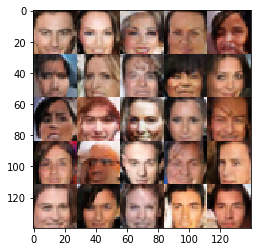

Epoch 7/10 Step 43300... Discriminator Loss: 1.3167... Generator Loss: 0.5705
Epoch 7/10 Step 43400... Discriminator Loss: 1.5118... Generator Loss: 0.6413


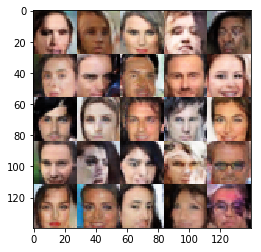

Epoch 7/10 Step 43500... Discriminator Loss: 1.6911... Generator Loss: 0.3812
Epoch 7/10 Step 43600... Discriminator Loss: 1.3206... Generator Loss: 0.6173


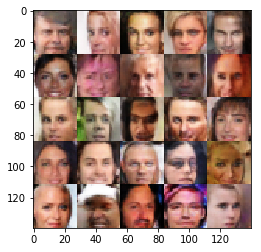

Epoch 7/10 Step 43700... Discriminator Loss: 1.2763... Generator Loss: 0.6322
Epoch 7/10 Step 43800... Discriminator Loss: 1.1216... Generator Loss: 0.8050


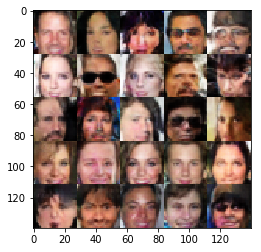

Epoch 7/10 Step 43900... Discriminator Loss: 1.4769... Generator Loss: 0.5408
Epoch 7/10 Step 44000... Discriminator Loss: 1.9106... Generator Loss: 0.3005


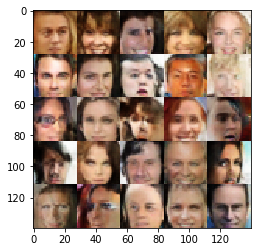

Epoch 7/10 Step 44100... Discriminator Loss: 1.8503... Generator Loss: 0.3011
Epoch 7/10 Step 44200... Discriminator Loss: 1.4123... Generator Loss: 0.6598


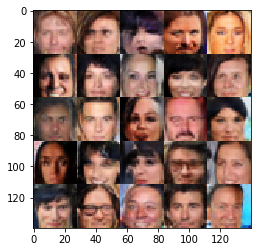

Epoch 7/10 Step 44300... Discriminator Loss: 1.1580... Generator Loss: 0.7924
Epoch 8/10 Step 44400... Discriminator Loss: 2.4851... Generator Loss: 0.1480


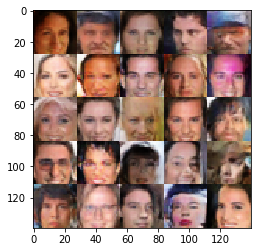

Epoch 8/10 Step 44500... Discriminator Loss: 2.2937... Generator Loss: 0.2424
Epoch 8/10 Step 44600... Discriminator Loss: 1.5723... Generator Loss: 0.4901


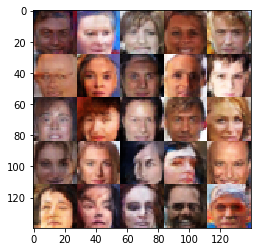

Epoch 8/10 Step 44700... Discriminator Loss: 1.7633... Generator Loss: 0.3264
Epoch 8/10 Step 44800... Discriminator Loss: 2.1089... Generator Loss: 0.2379


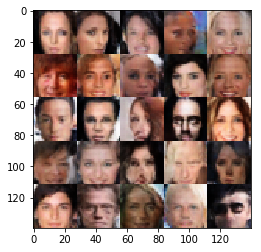

Epoch 8/10 Step 44900... Discriminator Loss: 1.1884... Generator Loss: 0.8985
Epoch 8/10 Step 45000... Discriminator Loss: 1.2837... Generator Loss: 0.6833


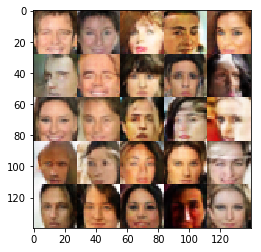

Epoch 8/10 Step 45100... Discriminator Loss: 1.6046... Generator Loss: 0.4406
Epoch 8/10 Step 45200... Discriminator Loss: 1.5865... Generator Loss: 0.4798


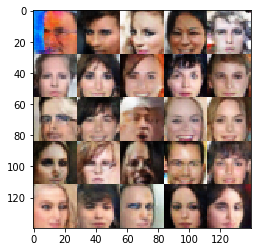

Epoch 8/10 Step 45300... Discriminator Loss: 1.6665... Generator Loss: 0.4079
Epoch 8/10 Step 45400... Discriminator Loss: 1.3404... Generator Loss: 0.5328


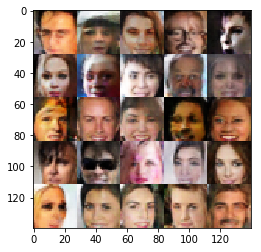

Epoch 8/10 Step 45500... Discriminator Loss: 1.8604... Generator Loss: 0.3173
Epoch 8/10 Step 45600... Discriminator Loss: 1.6733... Generator Loss: 0.3666


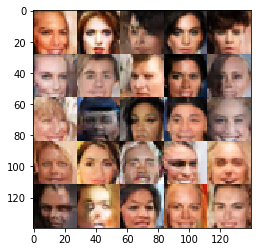

Epoch 8/10 Step 45700... Discriminator Loss: 1.4790... Generator Loss: 0.7521
Epoch 8/10 Step 45800... Discriminator Loss: 1.3956... Generator Loss: 0.5654


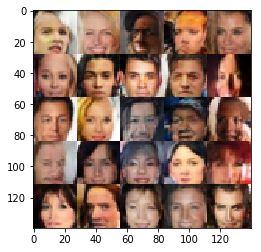

Epoch 8/10 Step 45900... Discriminator Loss: 1.3971... Generator Loss: 0.6543
Epoch 8/10 Step 46000... Discriminator Loss: 1.5440... Generator Loss: 0.4247


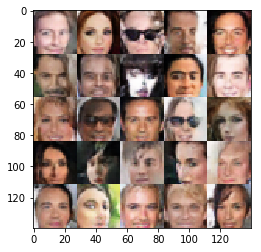

Epoch 8/10 Step 46100... Discriminator Loss: 1.3624... Generator Loss: 0.6589
Epoch 8/10 Step 46200... Discriminator Loss: 1.1076... Generator Loss: 0.8293


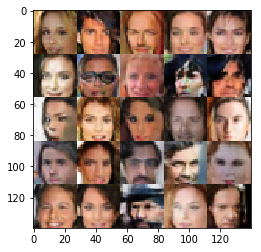

Epoch 8/10 Step 46300... Discriminator Loss: 1.0888... Generator Loss: 0.8454
Epoch 8/10 Step 46400... Discriminator Loss: 1.5532... Generator Loss: 0.4686


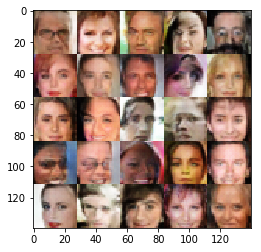

Epoch 8/10 Step 46500... Discriminator Loss: 0.8785... Generator Loss: 1.0294
Epoch 8/10 Step 46600... Discriminator Loss: 1.4818... Generator Loss: 0.4603


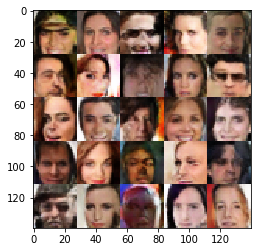

Epoch 8/10 Step 46700... Discriminator Loss: 1.9443... Generator Loss: 0.2720
Epoch 8/10 Step 46800... Discriminator Loss: 1.9140... Generator Loss: 0.3188


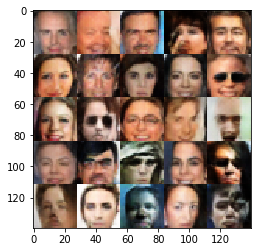

Epoch 8/10 Step 46900... Discriminator Loss: 1.1747... Generator Loss: 0.7475
Epoch 8/10 Step 47000... Discriminator Loss: 2.0227... Generator Loss: 0.2560


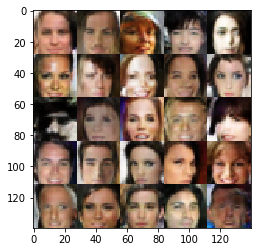

Epoch 8/10 Step 47100... Discriminator Loss: 1.5724... Generator Loss: 0.4255
Epoch 8/10 Step 47200... Discriminator Loss: 1.9105... Generator Loss: 0.2645


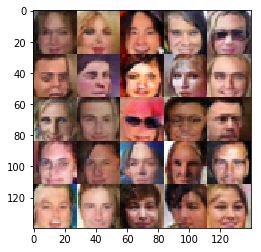

Epoch 8/10 Step 47300... Discriminator Loss: 1.4784... Generator Loss: 0.5731
Epoch 8/10 Step 47400... Discriminator Loss: 1.8953... Generator Loss: 0.2593


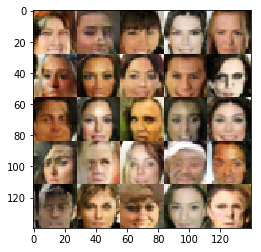

Epoch 8/10 Step 47500... Discriminator Loss: 1.8029... Generator Loss: 0.3335
Epoch 8/10 Step 47600... Discriminator Loss: 1.6107... Generator Loss: 0.3925


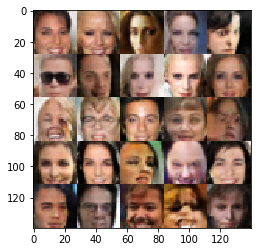

Epoch 8/10 Step 47700... Discriminator Loss: 1.3725... Generator Loss: 0.6817
Epoch 8/10 Step 47800... Discriminator Loss: 1.0731... Generator Loss: 1.1044


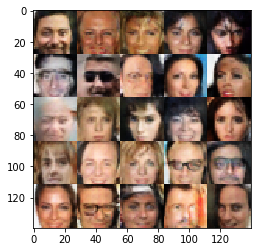

Epoch 8/10 Step 47900... Discriminator Loss: 1.4356... Generator Loss: 0.5859
Epoch 8/10 Step 48000... Discriminator Loss: 1.9713... Generator Loss: 0.2844


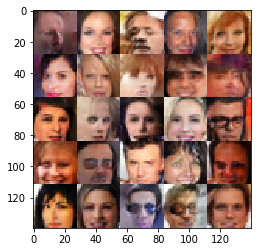

Epoch 8/10 Step 48100... Discriminator Loss: 1.9948... Generator Loss: 0.2589
Epoch 8/10 Step 48200... Discriminator Loss: 1.4985... Generator Loss: 0.5128


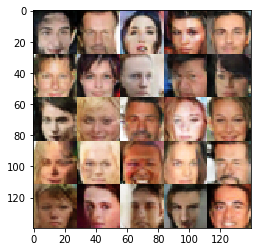

Epoch 8/10 Step 48300... Discriminator Loss: 0.8303... Generator Loss: 1.1165
Epoch 8/10 Step 48400... Discriminator Loss: 1.1010... Generator Loss: 2.0533


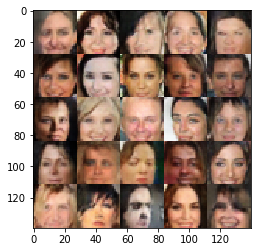

Epoch 8/10 Step 48500... Discriminator Loss: 1.5160... Generator Loss: 0.5258
Epoch 8/10 Step 48600... Discriminator Loss: 1.2975... Generator Loss: 0.8781


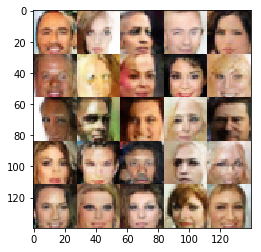

Epoch 8/10 Step 48700... Discriminator Loss: 2.3220... Generator Loss: 0.1906
Epoch 8/10 Step 48800... Discriminator Loss: 1.0527... Generator Loss: 1.1157


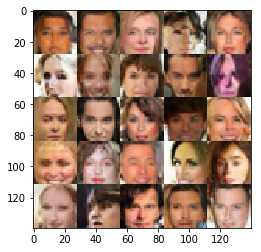

Epoch 8/10 Step 48900... Discriminator Loss: 1.5956... Generator Loss: 0.4349
Epoch 8/10 Step 49000... Discriminator Loss: 1.0269... Generator Loss: 0.8800


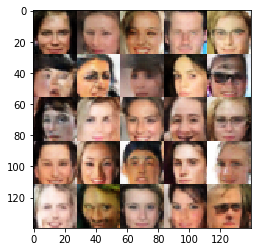

Epoch 8/10 Step 49100... Discriminator Loss: 1.6538... Generator Loss: 0.3762
Epoch 8/10 Step 49200... Discriminator Loss: 1.5946... Generator Loss: 0.4166


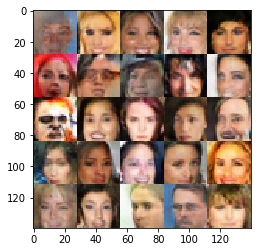

Epoch 8/10 Step 49300... Discriminator Loss: 1.5822... Generator Loss: 0.5055
Epoch 8/10 Step 49400... Discriminator Loss: 1.1333... Generator Loss: 0.8992


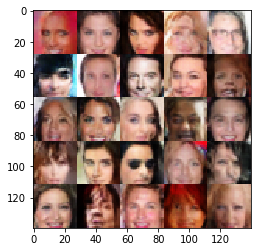

Epoch 8/10 Step 49500... Discriminator Loss: 1.4899... Generator Loss: 0.4903
Epoch 8/10 Step 49600... Discriminator Loss: 1.8202... Generator Loss: 0.3996


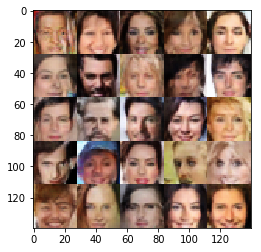

Epoch 8/10 Step 49700... Discriminator Loss: 1.9298... Generator Loss: 0.2796
Epoch 8/10 Step 49800... Discriminator Loss: 1.6930... Generator Loss: 0.3762


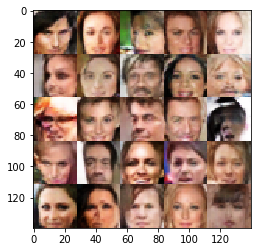

Epoch 8/10 Step 49900... Discriminator Loss: 1.6801... Generator Loss: 0.3625
Epoch 8/10 Step 50000... Discriminator Loss: 1.3028... Generator Loss: 1.1720


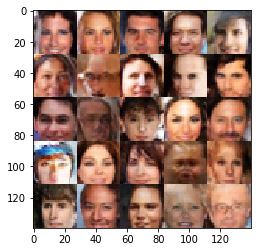

Epoch 8/10 Step 50100... Discriminator Loss: 0.9995... Generator Loss: 1.0100
Epoch 8/10 Step 50200... Discriminator Loss: 1.5672... Generator Loss: 0.7624


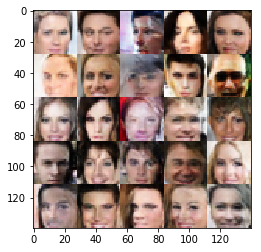

Epoch 8/10 Step 50300... Discriminator Loss: 0.9570... Generator Loss: 1.0709
Epoch 8/10 Step 50400... Discriminator Loss: 1.2972... Generator Loss: 0.7245


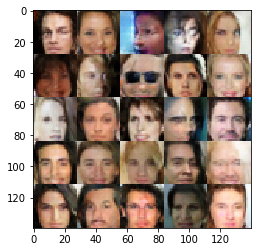

Epoch 8/10 Step 50500... Discriminator Loss: 2.0935... Generator Loss: 0.2318
Epoch 8/10 Step 50600... Discriminator Loss: 1.8168... Generator Loss: 0.2936


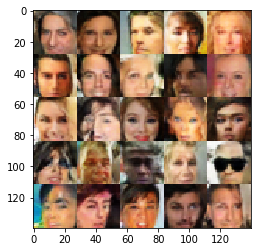

Epoch 9/10 Step 50700... Discriminator Loss: 2.3500... Generator Loss: 0.1732
Epoch 9/10 Step 50800... Discriminator Loss: 1.7896... Generator Loss: 0.3366


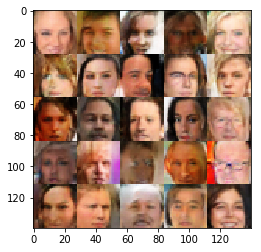

Epoch 9/10 Step 50900... Discriminator Loss: 1.1780... Generator Loss: 0.7559
Epoch 9/10 Step 51000... Discriminator Loss: 1.9426... Generator Loss: 0.2724


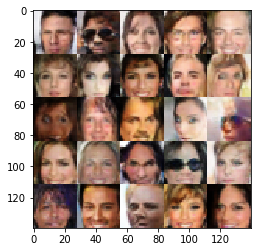

Epoch 9/10 Step 51100... Discriminator Loss: 1.2829... Generator Loss: 0.6434
Epoch 9/10 Step 51200... Discriminator Loss: 0.9690... Generator Loss: 0.9909


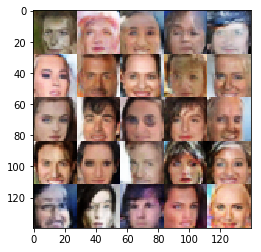

Epoch 9/10 Step 51300... Discriminator Loss: 1.1250... Generator Loss: 1.4241
Epoch 9/10 Step 51400... Discriminator Loss: 2.0034... Generator Loss: 0.2779


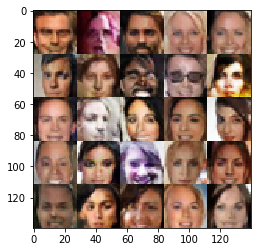

Epoch 9/10 Step 51500... Discriminator Loss: 1.2966... Generator Loss: 0.6475
Epoch 9/10 Step 51600... Discriminator Loss: 2.0566... Generator Loss: 0.2378


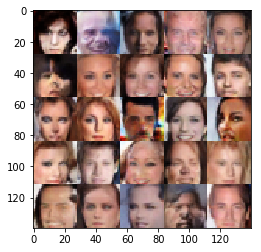

Epoch 9/10 Step 51700... Discriminator Loss: 0.7012... Generator Loss: 1.6457
Epoch 9/10 Step 51800... Discriminator Loss: 1.1213... Generator Loss: 0.7848


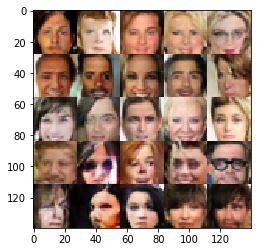

Epoch 9/10 Step 51900... Discriminator Loss: 1.5234... Generator Loss: 0.4440
Epoch 9/10 Step 52000... Discriminator Loss: 1.8243... Generator Loss: 0.2816


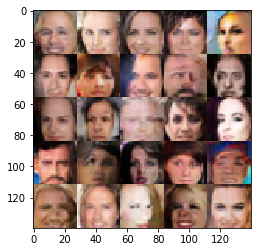

Epoch 9/10 Step 52100... Discriminator Loss: 1.4925... Generator Loss: 0.4685
Epoch 9/10 Step 52200... Discriminator Loss: 1.8596... Generator Loss: 0.3185


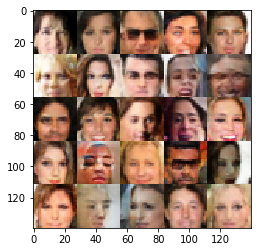

Epoch 9/10 Step 52300... Discriminator Loss: 1.2870... Generator Loss: 0.6981
Epoch 9/10 Step 52400... Discriminator Loss: 2.1938... Generator Loss: 0.2080


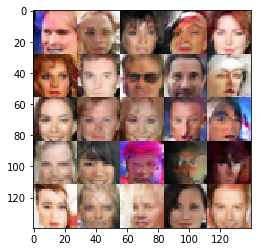

Epoch 9/10 Step 52500... Discriminator Loss: 1.0327... Generator Loss: 1.1016
Epoch 9/10 Step 52600... Discriminator Loss: 1.2209... Generator Loss: 0.7063


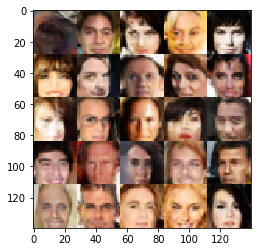

Epoch 9/10 Step 52700... Discriminator Loss: 1.9150... Generator Loss: 0.4443
Epoch 9/10 Step 52800... Discriminator Loss: 1.3240... Generator Loss: 0.7944


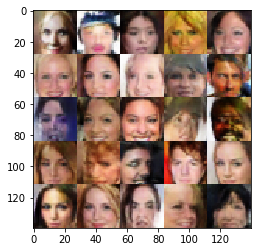

Epoch 9/10 Step 52900... Discriminator Loss: 1.9372... Generator Loss: 0.2639
Epoch 9/10 Step 53000... Discriminator Loss: 1.6040... Generator Loss: 0.5286


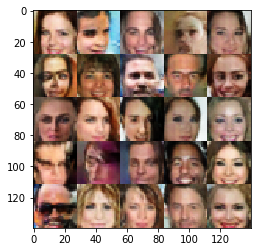

Epoch 9/10 Step 53100... Discriminator Loss: 1.4345... Generator Loss: 0.5285
Epoch 9/10 Step 53200... Discriminator Loss: 2.0147... Generator Loss: 0.2638


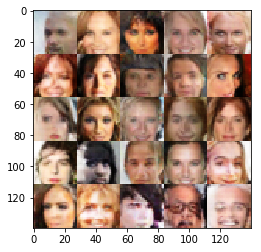

Epoch 9/10 Step 53300... Discriminator Loss: 1.3274... Generator Loss: 0.8439
Epoch 9/10 Step 53400... Discriminator Loss: 1.2839... Generator Loss: 0.7793


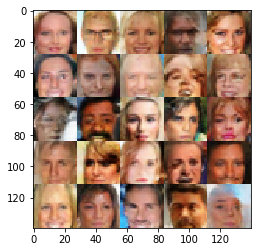

Epoch 9/10 Step 53500... Discriminator Loss: 0.8490... Generator Loss: 1.2081
Epoch 9/10 Step 53600... Discriminator Loss: 1.5816... Generator Loss: 0.4851


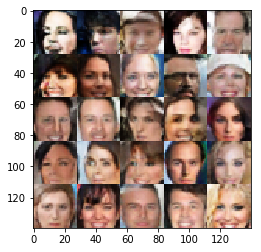

Epoch 9/10 Step 53700... Discriminator Loss: 2.1811... Generator Loss: 0.2017
Epoch 9/10 Step 53800... Discriminator Loss: 2.0865... Generator Loss: 0.6263


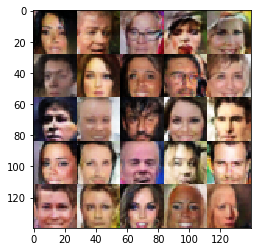

Epoch 9/10 Step 53900... Discriminator Loss: 1.3448... Generator Loss: 0.6137
Epoch 9/10 Step 54000... Discriminator Loss: 1.9551... Generator Loss: 0.2695


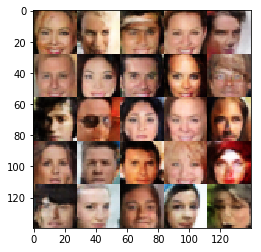

Epoch 9/10 Step 54100... Discriminator Loss: 2.0917... Generator Loss: 0.2295
Epoch 9/10 Step 54200... Discriminator Loss: 1.1332... Generator Loss: 0.7290


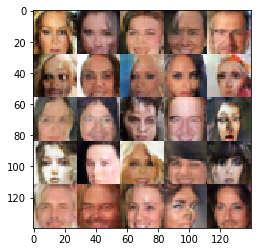

Epoch 9/10 Step 54300... Discriminator Loss: 1.2109... Generator Loss: 0.6983
Epoch 9/10 Step 54400... Discriminator Loss: 1.4992... Generator Loss: 0.4960


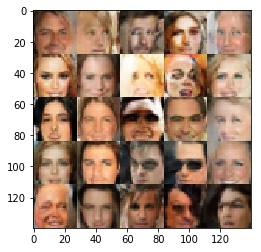

Epoch 9/10 Step 54500... Discriminator Loss: 1.8819... Generator Loss: 0.3130
Epoch 9/10 Step 54600... Discriminator Loss: 1.2758... Generator Loss: 0.6994


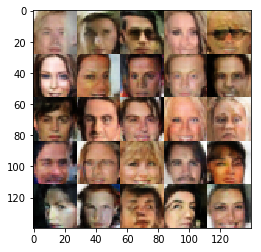

Epoch 9/10 Step 54700... Discriminator Loss: 2.0855... Generator Loss: 0.2626
Epoch 9/10 Step 54800... Discriminator Loss: 0.9407... Generator Loss: 0.9866


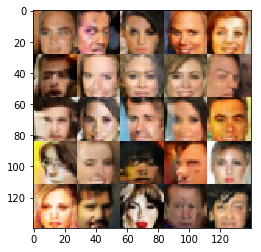

Epoch 9/10 Step 54900... Discriminator Loss: 1.9949... Generator Loss: 0.2893
Epoch 9/10 Step 55000... Discriminator Loss: 1.5080... Generator Loss: 0.5411


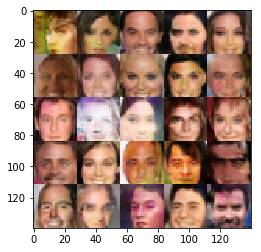

Epoch 9/10 Step 55100... Discriminator Loss: 1.7737... Generator Loss: 0.3581
Epoch 9/10 Step 55200... Discriminator Loss: 2.0876... Generator Loss: 0.2296


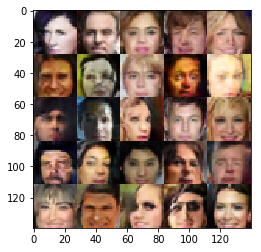

Epoch 9/10 Step 55300... Discriminator Loss: 1.3290... Generator Loss: 0.6458
Epoch 9/10 Step 55400... Discriminator Loss: 1.9645... Generator Loss: 0.2679


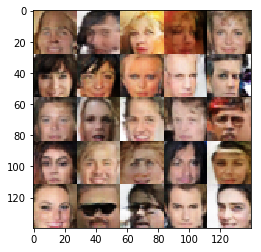

Epoch 9/10 Step 55500... Discriminator Loss: 2.0433... Generator Loss: 0.2472
Epoch 9/10 Step 55600... Discriminator Loss: 2.2905... Generator Loss: 0.2000


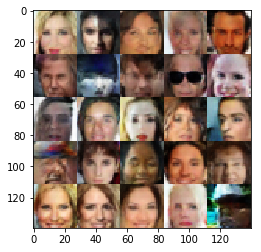

Epoch 9/10 Step 55700... Discriminator Loss: 2.0051... Generator Loss: 0.2633
Epoch 9/10 Step 55800... Discriminator Loss: 1.4071... Generator Loss: 0.5957


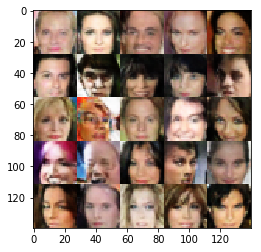

Epoch 9/10 Step 55900... Discriminator Loss: 1.7104... Generator Loss: 0.3859
Epoch 9/10 Step 56000... Discriminator Loss: 2.0968... Generator Loss: 0.2351


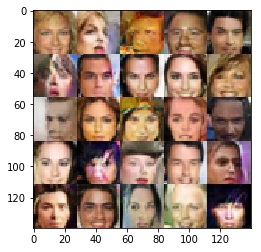

Epoch 9/10 Step 56100... Discriminator Loss: 1.4052... Generator Loss: 0.5323
Epoch 9/10 Step 56200... Discriminator Loss: 1.6917... Generator Loss: 0.3437


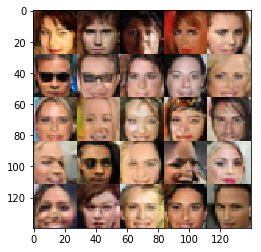

Epoch 9/10 Step 56300... Discriminator Loss: 2.0083... Generator Loss: 0.2849
Epoch 9/10 Step 56400... Discriminator Loss: 1.8284... Generator Loss: 0.2984


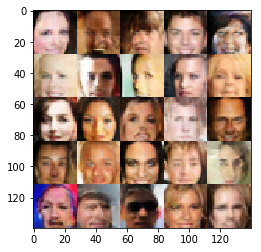

Epoch 9/10 Step 56500... Discriminator Loss: 1.2633... Generator Loss: 0.6719
Epoch 9/10 Step 56600... Discriminator Loss: 2.1851... Generator Loss: 0.2469


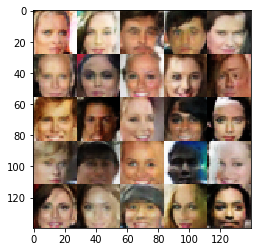

Epoch 9/10 Step 56700... Discriminator Loss: 1.5283... Generator Loss: 0.4504
Epoch 9/10 Step 56800... Discriminator Loss: 2.2618... Generator Loss: 0.2326


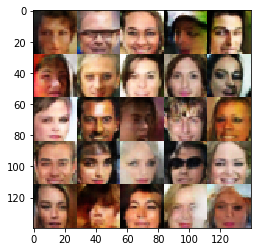

Epoch 9/10 Step 56900... Discriminator Loss: 1.3904... Generator Loss: 0.5318
Epoch 10/10 Step 57000... Discriminator Loss: 0.8730... Generator Loss: 1.0931


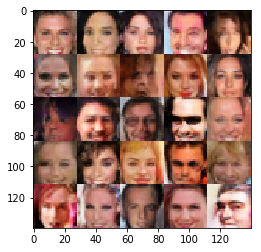

Epoch 10/10 Step 57100... Discriminator Loss: 1.8317... Generator Loss: 0.3391
Epoch 10/10 Step 57200... Discriminator Loss: 1.4177... Generator Loss: 1.1143


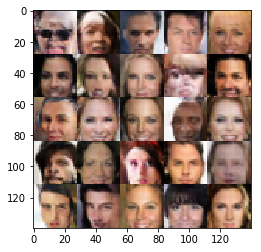

Epoch 10/10 Step 57300... Discriminator Loss: 1.4954... Generator Loss: 0.5989
Epoch 10/10 Step 57400... Discriminator Loss: 1.8412... Generator Loss: 0.3819


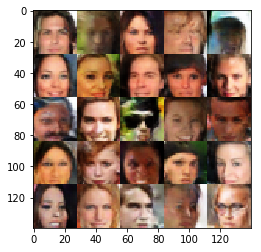

Epoch 10/10 Step 57500... Discriminator Loss: 1.7160... Generator Loss: 0.3656
Epoch 10/10 Step 57600... Discriminator Loss: 1.3643... Generator Loss: 0.6628


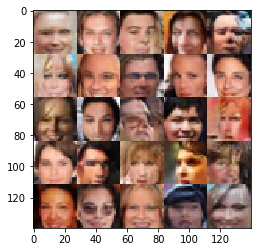

Epoch 10/10 Step 57700... Discriminator Loss: 1.2517... Generator Loss: 0.7194
Epoch 10/10 Step 57800... Discriminator Loss: 1.4631... Generator Loss: 0.5744


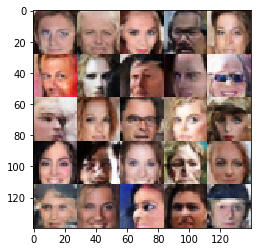

Epoch 10/10 Step 57900... Discriminator Loss: 1.8439... Generator Loss: 0.3040
Epoch 10/10 Step 58000... Discriminator Loss: 2.1712... Generator Loss: 0.2178


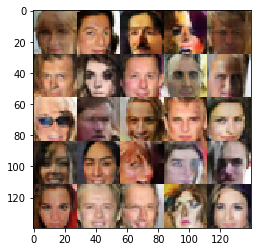

Epoch 10/10 Step 58100... Discriminator Loss: 1.1534... Generator Loss: 0.6806
Epoch 10/10 Step 58200... Discriminator Loss: 0.8575... Generator Loss: 1.7213


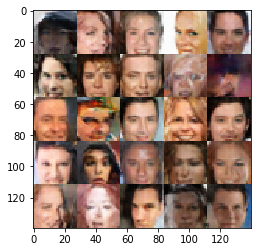

Epoch 10/10 Step 58300... Discriminator Loss: 1.9450... Generator Loss: 0.3039
Epoch 10/10 Step 58400... Discriminator Loss: 1.4069... Generator Loss: 0.8637


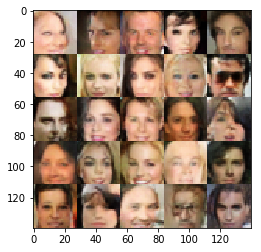

Epoch 10/10 Step 58500... Discriminator Loss: 1.3897... Generator Loss: 0.5820
Epoch 10/10 Step 58600... Discriminator Loss: 1.4237... Generator Loss: 0.5302


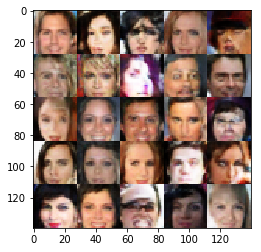

Epoch 10/10 Step 58700... Discriminator Loss: 1.8296... Generator Loss: 0.3404
Epoch 10/10 Step 58800... Discriminator Loss: 1.4225... Generator Loss: 0.5988


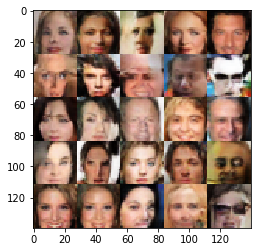

Epoch 10/10 Step 58900... Discriminator Loss: 1.7058... Generator Loss: 0.3654
Epoch 10/10 Step 59000... Discriminator Loss: 1.2523... Generator Loss: 0.7128


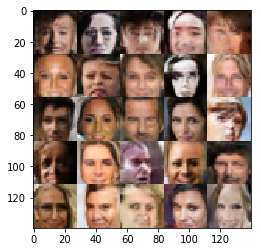

Epoch 10/10 Step 59100... Discriminator Loss: 2.2351... Generator Loss: 0.2029
Epoch 10/10 Step 59200... Discriminator Loss: 1.8669... Generator Loss: 0.3374


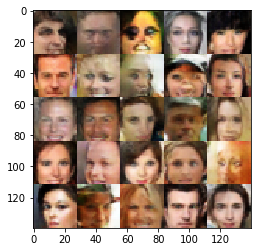

Epoch 10/10 Step 59300... Discriminator Loss: 1.7076... Generator Loss: 0.4261
Epoch 10/10 Step 59400... Discriminator Loss: 1.7853... Generator Loss: 0.3456


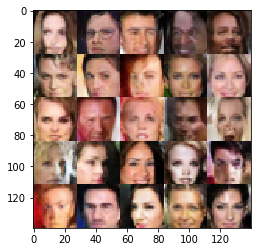

Epoch 10/10 Step 59500... Discriminator Loss: 1.2539... Generator Loss: 0.7260
Epoch 10/10 Step 59600... Discriminator Loss: 1.7676... Generator Loss: 0.4838


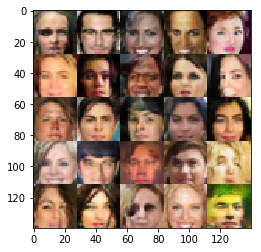

Epoch 10/10 Step 59700... Discriminator Loss: 1.7922... Generator Loss: 0.3506
Epoch 10/10 Step 59800... Discriminator Loss: 1.2058... Generator Loss: 0.7736


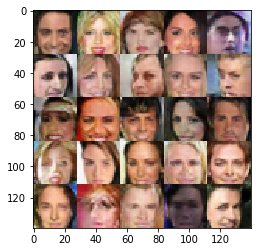

Epoch 10/10 Step 59900... Discriminator Loss: 2.1072... Generator Loss: 0.2271
Epoch 10/10 Step 60000... Discriminator Loss: 1.6313... Generator Loss: 0.5129


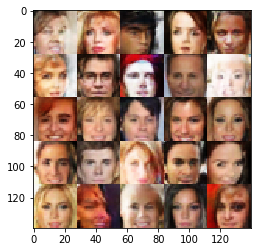

Epoch 10/10 Step 60100... Discriminator Loss: 2.1353... Generator Loss: 0.2184
Epoch 10/10 Step 60200... Discriminator Loss: 1.9593... Generator Loss: 0.2912


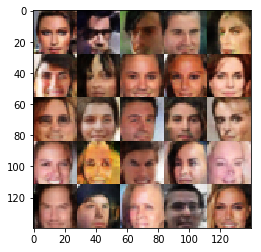

Epoch 10/10 Step 60300... Discriminator Loss: 1.8917... Generator Loss: 0.2933
Epoch 10/10 Step 60400... Discriminator Loss: 1.8981... Generator Loss: 0.3144


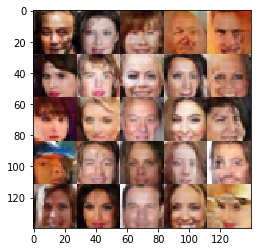

Epoch 10/10 Step 60500... Discriminator Loss: 2.2913... Generator Loss: 0.2094
Epoch 10/10 Step 60600... Discriminator Loss: 1.3807... Generator Loss: 0.7082


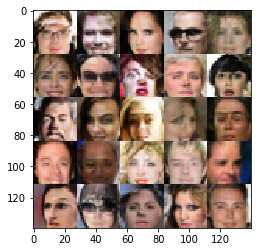

Epoch 10/10 Step 60700... Discriminator Loss: 1.2627... Generator Loss: 0.6234
Epoch 10/10 Step 60800... Discriminator Loss: 2.5605... Generator Loss: 0.1609


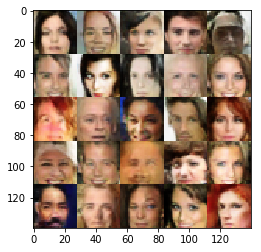

Epoch 10/10 Step 60900... Discriminator Loss: 1.4625... Generator Loss: 0.5349
Epoch 10/10 Step 61000... Discriminator Loss: 1.5662... Generator Loss: 0.5943


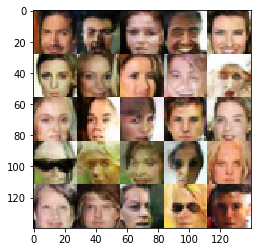

Epoch 10/10 Step 61100... Discriminator Loss: 1.5536... Generator Loss: 0.4774
Epoch 10/10 Step 61200... Discriminator Loss: 1.3737... Generator Loss: 0.5521


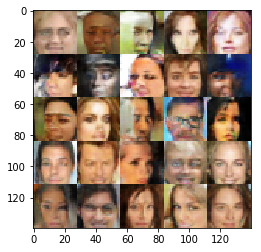

Epoch 10/10 Step 61300... Discriminator Loss: 1.8799... Generator Loss: 0.3377
Epoch 10/10 Step 61400... Discriminator Loss: 1.3768... Generator Loss: 0.6544


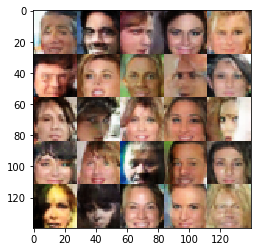

Epoch 10/10 Step 61500... Discriminator Loss: 1.9844... Generator Loss: 0.2867
Epoch 10/10 Step 61600... Discriminator Loss: 2.7347... Generator Loss: 0.1292


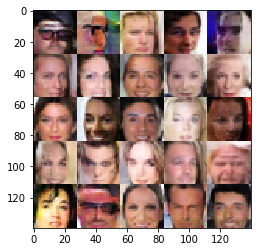

Epoch 10/10 Step 61700... Discriminator Loss: 2.4237... Generator Loss: 0.1782
Epoch 10/10 Step 61800... Discriminator Loss: 1.9153... Generator Loss: 0.2916


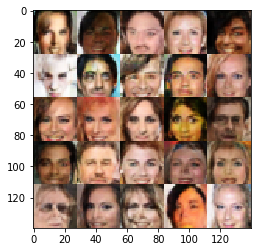

Epoch 10/10 Step 61900... Discriminator Loss: 1.3792... Generator Loss: 0.6503
Epoch 10/10 Step 62000... Discriminator Loss: 1.7464... Generator Loss: 0.4197


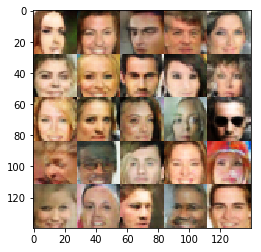

Epoch 10/10 Step 62100... Discriminator Loss: 2.1878... Generator Loss: 0.2763
Epoch 10/10 Step 62200... Discriminator Loss: 1.1145... Generator Loss: 0.9397


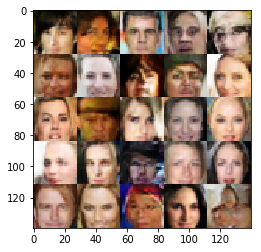

Epoch 10/10 Step 62300... Discriminator Loss: 1.1654... Generator Loss: 0.9023
Epoch 10/10 Step 62400... Discriminator Loss: 1.7110... Generator Loss: 0.4058


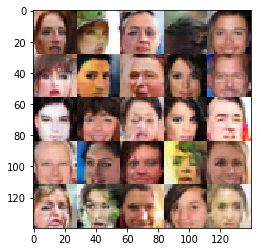

Epoch 10/10 Step 62500... Discriminator Loss: 1.7725... Generator Loss: 0.3682
Epoch 10/10 Step 62600... Discriminator Loss: 2.4130... Generator Loss: 0.1762


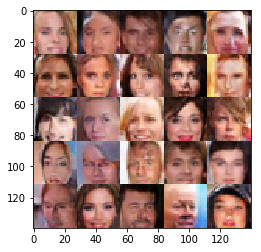

Epoch 10/10 Step 62700... Discriminator Loss: 1.6005... Generator Loss: 0.4563
Epoch 10/10 Step 62800... Discriminator Loss: 1.2965... Generator Loss: 0.8482


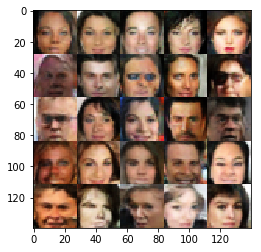

Epoch 10/10 Step 62900... Discriminator Loss: 1.6177... Generator Loss: 0.5932
Epoch 10/10 Step 63000... Discriminator Loss: 2.4218... Generator Loss: 0.1706


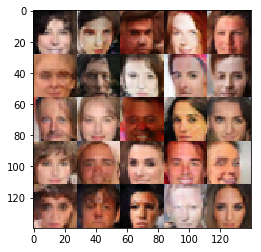

Epoch 10/10 Step 63100... Discriminator Loss: 1.3212... Generator Loss: 0.5548
Epoch 10/10 Step 63200... Discriminator Loss: 1.0664... Generator Loss: 0.7593


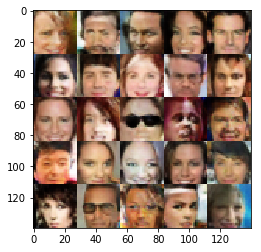

Epoch 10/10 Step 63300... Discriminator Loss: 1.7250... Generator Loss: 0.4287


In [12]:
batch_size = 32
z_dim = 100
learning_rate = 0.001
beta1 = 0.5



"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 10

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### 提交项目
提交本项目前，确保运行所有 cells 后保存该文件。

保存该文件为 "dlnd_face_generation.ipynb"， 并另存为 HTML 格式 "File" -> "Download as"。提交项目时请附带 "helper.py" 和 "problem_unittests.py" 文件。